# Convolutional Neural Networks

So far we used fully connected layers, where the input is fully connected to each node in the following layer. Convolutional neural networks use a "filter kernel" instead, where each node is conduction a convolution like a filter.

The filter kernel is also described as a "receptive field" of a certain size. At each position of this receptive field, an output is produced. Then it is shifted by a distance called "stride", and a new output is produced, and so on.

This has the advantage, that the network is less dependent on the precise location of a signal to detect or recognize.

There are convolutional layer for 1 to 3 dimensions:

```python
torch.nn.Conv1d
torch.nn.Conv2d
torch.nn.Conv3d
```

For the case of the MNIST digit recognition we need 2d convolution, defined as:

```python
torch.nn.Conv2d(in_channels, out_channels, kernel_size, 
                stride=1, padding=0, dilation=1, groups=1, 
                bias=True, padding_mode='zeros')
```

In [1]:
%%html
<iframe src="https://pytorch.org/docs/stable/generated/torch.nn.Conv2d.html#torch.nn.Conv2d" width="900" height="600"></iframe>

"padding" here means a zero padding at the ends of the signals, for instance the boundary of our images. For padding=0, only valid points are computed, which means the kernel does not reach over the boundaries. For instance if the kernel has a size of 3, we need "padding=1" to obtain the same output size as the input.

This is the Pytorch convolutional neural network class for the MNIST digit recognition task,

```python
class ConvNet(nn.Module):
    def __init__(self):
        super(ConvNet, self).__init__()
        self.conv1 = nn.Conv2d(1, 10, kernel_size=5)
        self.conv2 = nn.Conv2d(10, 20, kernel_size=5)
        self.fc1 = nn.Linear(20, 10)
        
    def forward(self, x):
        #print("x_input.shape=", x.shape)
        x = F.relu(F.max_pool2d(self.conv1(x), 4))
        x = F.relu(F.max_pool2d(self.conv2(x), 2))
        #print("x.shape=", x.shape)
        x = x.view(-1, 20) 
        #80 for pool: 2,4; ((((28-(5-1))/2-(5-1))/4)**2)*20
        #20 for pool: 4,2: ((((28-(5-1))/4-(5-1))/2)**2)*20
        x = F.relu(self.fc1(x)) #10 outputs, 1 for each class.
        return x #F.log_softmax(x)
```

For the loss function we take again the CrossEntroyLoss, and for the optimizer "adam",

```python
torch.save({'model_state_dict':model.state_dict(),'optimizer_state_dict':optimizer.state_dict()},
           "mnistexample_pytorch_convnet2_weights.torch")
```

We can compare this with the case of our fully connected network, and will see that indeed we only have a fraction of the weights in our convolutional network compared with the fully connected network. This is an advantage for an implementation on smaller hardware.

We can then train the convolutional network as before. Here we see a disadvantage: it takes much longer to train, we need 1000 iterations or more to obtain a good solution, as compared to only 10 iterations for the fully connected network!


In [2]:
#from: https://machinelearningmastery.com/handwritten-digit-recognition-using-convolutional-neural-networks-python-keras/
#https://pytorch.org/docs/stable/torchvision/datasets.html#mnist
#Translated to PyTorch, and using a convulutional neural network instead, 
#2: with more conv layers
#by Gerald Schuller, October 2019

# Ported to Jupyter Notebook by Renato Profeta, October 2020

In [3]:
import numpy
import matplotlib.pyplot as plt
import torch
import torchvision
import torch.nn.functional as F
import torch.nn as nn
import time

device='cpu'
#device='cuda'

In [4]:
# define baseline model
class ConvNet(nn.Module):
    def __init__(self):
        super(ConvNet, self).__init__()
        self.conv1 = nn.Conv2d(1, 10, kernel_size=5)
        self.conv2 = nn.Conv2d(10, 20, kernel_size=5)
        self.fc1 = nn.Linear(20, 10)

    def forward(self, x):
        #print("x_input.shape=", x.shape)
        x = F.relu(F.max_pool2d(self.conv1(x), 4))
        x = F.relu(F.max_pool2d(self.conv2(x), 2))
        #print("x.shape=", x.shape)
        x = x.view(-1, 20) #80 for pool: 2,4; ((((28-(5-1))/2-(5-1))/4)**2)*20
        #20 for pool: 4,2: ((((28-(5-1))/4-(5-1))/2)**2)*20
        x = F.relu(self.fc1(x)) #10 outputs, 1 for each class.
        return x #F.log_softmax(x)

In [5]:
batch_size_train = 100
batch_size_test = 10
num_classes = 10

In [6]:
train_loader = torch.utils.data.DataLoader(
  torchvision.datasets.MNIST('~/Downloads/MNISTfiles/', train=True, download=True,
                             transform=torchvision.transforms.Compose([
                               torchvision.transforms.ToTensor(),
                               torchvision.transforms.Normalize(
                                 (0.1307,), (0.3081,))
                             ])),
  batch_size=batch_size_train, shuffle=False)

#the Normalize numbers are mean and standard deviation.
test_loader = torch.utils.data.DataLoader(
  torchvision.datasets.MNIST('~/Downloads/MNISTfiles/', train=False, download=True,
                             transform=torchvision.transforms.Compose([
                               torchvision.transforms.ToTensor(),
                               torchvision.transforms.Normalize(
                                 (0.1307,), (0.3081,))
                             ])),
  batch_size=batch_size_test, shuffle=True)

In [7]:
examples = enumerate(train_loader)
# Plot ad hoc mnist instances

# load (downloaded if needed) the MNIST dataset
#(X_train, y_train), (X_test, y_test) = mnist.load_data()
#one batch of 100 images:
batch_idx, (X_train, y_train) = next(examples)
print("batch_idx=", batch_idx, "X_train.shape=", X_train.shape, "y_train.shape=", y_train.shape, "y_train=", y_train)
examples = enumerate(test_loader)
#one batch of 100 images:
batch_idx, (X_test, y_test) = next(examples)

batch_idx= 0 X_train.shape= torch.Size([100, 1, 28, 28]) y_train.shape= torch.Size([100]) y_train= tensor([5, 0, 4, 1, 9, 2, 1, 3, 1, 4, 3, 5, 3, 6, 1, 7, 2, 8, 6, 9, 4, 0, 9, 1,
        1, 2, 4, 3, 2, 7, 3, 8, 6, 9, 0, 5, 6, 0, 7, 6, 1, 8, 7, 9, 3, 9, 8, 5,
        9, 3, 3, 0, 7, 4, 9, 8, 0, 9, 4, 1, 4, 4, 6, 0, 4, 5, 6, 1, 0, 0, 1, 7,
        1, 6, 3, 0, 2, 1, 1, 7, 9, 0, 2, 6, 7, 8, 3, 9, 0, 4, 6, 7, 4, 6, 8, 0,
        7, 8, 3, 1])


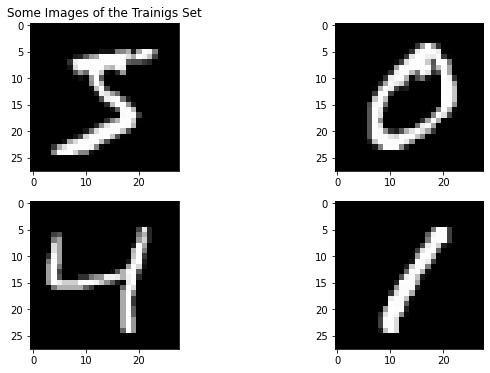

In [8]:
# plot 4 images as gray scale
plt.figure(figsize=(10,6))
plt.subplot(221)
plt.title("Some Images of the Trainigs Set")
plt.imshow(X_train[0,0], cmap=plt.get_cmap('gray'))
plt.subplot(222)
plt.imshow(X_train[1,0], cmap=plt.get_cmap('gray'))
plt.subplot(223)
plt.imshow(X_train[2,0], cmap=plt.get_cmap('gray'))
plt.subplot(224)
plt.imshow(X_train[3,0], cmap=plt.get_cmap('gray'))
# show the plot


X_testunflat=X_test.clone() #keep original for imshow later
# flatten 28*28 images to a 784 vector for each image
num_pixels = X_train.shape[2] * X_train.shape[3]


In [9]:
# build the model
print("Generate Model:")
model = ConvNet()#.to('cpu')
    
loss_fn = nn.CrossEntropyLoss()
#learning_rate = 1e-4
optimizer = torch.optim.Adam(model.parameters())#, lr=learning_rate)

try:
    checkpoint = torch.load("mnistexample_pytorch_convnet2_weights.torch",map_location='cpu')
    model.load_state_dict(checkpoint['model_state_dict'])
    #optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    print("Read weights from mnistexample_pytorch_convnet2_weights.torch")
except IOError:
    print("fresh start")

Generate Model:
Read weights from mnistexample_pytorch_convnet2_weights.torch


In [10]:
# Fit the model
X_train=X_train.to(device)
y_train=y_train.to(device)
starttime=time.time()
for epoch in range(1000):
    Ypred=model(X_train)
    loss=loss_fn(Ypred, y_train)
    if epoch%2==0:
        print(epoch, loss.item())
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()
endtime=time.time()
print("Duration of optimization:", endtime-starttime)

#model.fit(X_train, y_train, validation_data=(X_test, y_test), epochs=2, batch_size=200, verbose=2)
# Final evaluation of the model
Ypred=model(X_test)
loss=loss_fn(Ypred, y_test)
#scores = model.forward(X_test, y_test, verbose=0)
print("Loss on the test set:", loss)

0 1.1052403450012207
2 1.1052403450012207
4 1.1052403450012207
6 1.1052403450012207
8 1.1052403450012207
10 1.1052403450012207
12 1.1052403450012207
14 1.1052403450012207
16 1.1052403450012207
18 1.1052403450012207
20 1.1052403450012207
22 1.1052403450012207
24 1.1052403450012207
26 1.1052403450012207
28 1.1052403450012207
30 1.1052403450012207
32 1.1052403450012207
34 1.1052403450012207
36 1.1052403450012207
38 1.1052403450012207
40 1.1052403450012207
42 1.1052403450012207
44 1.1052403450012207
46 1.1052403450012207
48 1.1052403450012207
50 1.1052403450012207
52 1.1052403450012207
54 1.1052403450012207
56 1.1052403450012207
58 1.1052403450012207
60 1.1052403450012207
62 1.1052403450012207
64 1.1052403450012207
66 1.1052403450012207
68 1.1052403450012207
70 1.1052403450012207
72 1.1052403450012207
74 1.1052403450012207
76 1.1052403450012207
78 1.1052403450012207
80 1.1052403450012207
82 1.1052403450012207
84 1.1052403450012207
86 1.1052403450012207
88 1.1052403450012207
90 1.1052403450

720 1.1052402257919312
722 1.1052402257919312
724 1.1052402257919312
726 1.1052402257919312
728 1.1052402257919312
730 1.1052402257919312
732 1.1052402257919312
734 1.1052402257919312
736 1.1052402257919312
738 1.1052402257919312
740 1.1052402257919312
742 1.1052402257919312
744 1.1052402257919312
746 1.1052402257919312
748 1.1052402257919312
750 1.1052402257919312
752 1.1052402257919312
754 1.1052402257919312
756 1.1052402257919312
758 1.1052402257919312
760 1.1052402257919312
762 1.1052402257919312
764 1.1052402257919312
766 1.1052402257919312
768 1.1052402257919312
770 1.1052402257919312
772 1.1052402257919312
774 1.1052402257919312
776 1.1052402257919312
778 1.1052402257919312
780 1.1052402257919312
782 1.1052402257919312
784 1.1052402257919312
786 1.1052402257919312
788 1.1052402257919312
790 1.1052402257919312
792 1.1052402257919312
794 1.1052402257919312
796 1.1052402257919312
798 1.1052402257919312
800 1.1052402257919312
802 1.1052402257919312
804 1.1052402257919312
806 1.10524

Wrote to mnistexample_pytorch_convnet2_weights.torch
sample.shape= torch.Size([1, 1, 28, 28])
prediction= tensor(9)


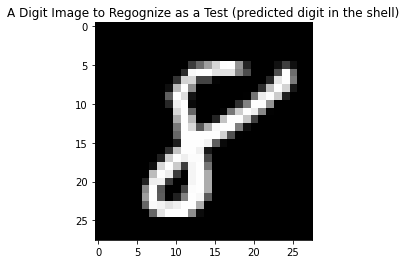

In [11]:
torch.save({
       'model_state_dict': model.state_dict(),
       'optimizer_state_dict': optimizer.state_dict()}, "mnistexample_pytorch_convnet2_weights.torch")
print("Wrote to mnistexample_pytorch_convnet2_weights.torch")

plt.figure()
plt.imshow(X_testunflat[3,0], cmap=plt.get_cmap('gray'))
plt.title("A Digit Image to Regognize as a Test (predicted digit in the shell)")

sample=X_test[3,:]
sample=sample[None,:,:,:] #add the batch dimension for conv2d input.
print("sample.shape=", sample.shape)
prediction=torch.argmax(model(sample))
print("prediction=", prediction)

## 1-D Convolutional Networks for Audio Processing

### A 1-D Signal Detector

We can use 1-dimensional convolutional networks for audio processing. Examples are matched filters and predictors, as shown in letcure 13 and 14 of Advanced Signal Processing.

Construct a signal "sig" (length 11):

In [12]:
import numpy as np
sig = np.arange(0, 1.1, 0.1)
sig

array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ])

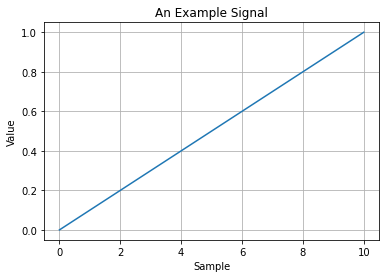

In [13]:
import matplotlib.pyplot as plt
plt.figure()
plt.plot(sig)
plt.xlabel('Sample')
plt.ylabel('Value')
plt.title('An Example Signal')
plt.grid()

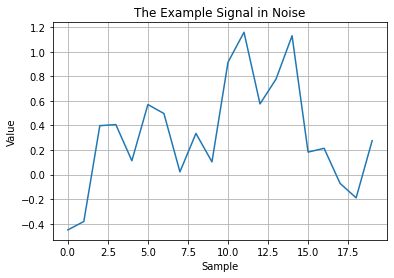

In [14]:
signoise = np.random.rand(20)-0.5+np.hstack([np.zeros(4),sig,np.zeros(5)])
plt.figure()
plt.plot(signoise)
plt.xlabel('Sample')
plt.ylabel('Value')
plt.title('The Example Signal in Noise')
plt.grid()

We need to convert this signal to a pytorch type, and write a function "signal2pytorch(x)" for it.

We can implement a filter similar to a matched filter using a 1-dimensional "convolutional layer", conv1d, without "bias" and without a non-linear "activation function".

For it we need to specify a "training" signal, here our signal to detect (the "ramp" function) x, and the "target" signal y, which is the desired output of the convolutional layer which the optimization should reach as closely as possible during the optimization or "training",

```python
x= np.hstack((np.zeros(4),np.arange(0,1.1,0.1),np.zeros(5)))
y = np.zeros(30)
y[16]=1 #Detecting the signal at its end
```

Observe that for the target y we specified a single peak (the "1") at the position the filter should detect the signal, and zeros everywhere else. This also leads to a minimization of the output outside the signal detection, which we didn’t have in our closed form solution for a matched filter!

We specify our convolutional detector layer as,

```python 
detector=nn.Sequential(nn.Conv1d(in_channels=1,
                                 out_channels=1,kernel_size=11, 
                                 stride=1, padding=10, bias=False))
```

Observe that here padding=kernel_size-1, which leads to a **causal** filter, meaning all its inputs are not in the future. This implements our linear filter as detector. The optimization we apply minimizes the **mean squared error** (the so called "L2 loss function").

We can let the optimization run on the same ramp function as before and display the output of the detector with the clean and noisy signal as input with,



In [15]:
# -*- coding: utf-8 -*-
__author__ = 'Gerald Schuller'
__copyright__ = 'G.S.'

"""
Simple program to use a convolutional neural network to obtain a signal detector like matched filter,  using pytorch.
Gerald Schuller, November 2018.
""";
# Ported to Jupyter Notebook by Renato Profeta, October 2020

In [16]:
import torch 
import torch.nn as nn

import numpy as np
import matplotlib.pyplot as plt
import sys

if sys.version_info[0] < 3:
   # for Python 2
   import cPickle as pickle
else:
   # for Python 3
   import pickle

In [17]:
# Device configuration
#device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

def signal2pytorch(x):
    #Function to convert a signal vector s, like a mono audio signal, into a 3-d Tensor that conv1d of Pytorch expects,
    #https://pytorch.org/docs/stable/nn.html
    #conv1d Input: (N,Cin,Lin), Cin: numer of input channels (e.g. for stereo), Lin: length of signal, N: number of Batches (signals) 
    #Argument x: a 1-d signal as numpy array
    #output: 3-d Tensor X for conv1d input.
    X = np.expand_dims(x, axis=0)  #add channels dimension (here only 1 channel)
    X = np.expand_dims(X, axis=0)  #add batch dimension (here only 1 batch)
    X=torch.from_numpy(X)
    X=X.type(torch.Tensor)
    return X

In [18]:
class ConvNet(nn.Module):
    def __init__(self):
        super(ConvNet, self).__init__()
        self.detector=nn.Sequential(nn.Conv1d(in_channels=1, out_channels=1, kernel_size=11, stride=1, padding=10, bias=False))
        #self.detector=nn.Conv1d(1, 1, 8, padding=8, stride=1, bias=False)
   
    def forward(self, x):
        out = self.detector(x)
        return out

In [19]:
#Input signal X, a Ramp function:
x= np.hstack((np.zeros(4),np.arange(0,1.1,0.1),np.zeros(5)))
print("x=", x)
X=signal2pytorch(x)
y = np.zeros(30)
y[16]=1 #Detecting the signal at its end (for convolution padding='causal'), like a matched filter.
print("y=", y)
Y=signal2pytorch(y)
    
print("Input X[0,0,:]=", X[0,0,:], "X.shape=", X.shape )
print("Target Y[0,0,:]=", Y[0,0,:], "Y.shape=", Y.shape)
    
print("Generate Model:")
#model = generate_model()     # Compile an neural net
model = ConvNet()#.to('cpu')
print("Def. loss function:")
loss_fn = nn.MSELoss(reduction='sum')
#learning_rate = 1e-4
optimizer = torch.optim.Adam(model.parameters())#, lr=learning_rate)

x= [0.  0.  0.  0.  0.  0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9 1.  0.  0.  0.
 0.  0. ]
y= [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0.]
Input X[0,0,:]= tensor([0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.1000, 0.2000, 0.3000, 0.4000,
        0.5000, 0.6000, 0.7000, 0.8000, 0.9000, 1.0000, 0.0000, 0.0000, 0.0000,
        0.0000, 0.0000]) X.shape= torch.Size([1, 1, 20])
Target Y[0,0,:]= tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]) Y.shape= torch.Size([1, 1, 30])
Generate Model:
Def. loss function:


In [20]:
for epoch in range(5000):
    Ydet=model(X)
    loss=loss_fn(Ydet, Y)
    if epoch%100==0:
        print(epoch, loss.item())
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

0 1.0429491996765137
100 0.679328203201294
200 0.5094031691551208
300 0.3944973349571228
400 0.3112485706806183
500 0.24734964966773987
600 0.19640877842903137
700 0.15519581735134125
800 0.12190943211317062
900 0.095310278236866
1000 0.0743730217218399
1100 0.058178480714559555
1200 0.045891210436820984
1300 0.0367613360285759
1400 0.030128244310617447
1500 0.02542388252913952
1600 0.02217213623225689
1700 0.019985070452094078
1800 0.01855606585741043
1900 0.017650475725531578
2000 0.017094777897000313
2100 0.016765130683779716
2200 0.016576414927840233
2300 0.016472328454256058
2400 0.016417117789387703
2500 0.01638902723789215
2600 0.01637532189488411
2700 0.0163689237087965
2800 0.01636609062552452
2900 0.01636488549411297
3000 0.016364404931664467
3100 0.016364220529794693
3200 0.01636415161192417
3300 0.016364136710762978
3400 0.01636413484811783
3500 0.016364121809601784
3600 0.016364121809601784
3700 0.016364138573408127
3800 0.016364121809601784
3900 0.01636412739753723
4000 0

In [21]:
torch.save(model.state_dict(), 'model_detector.torch')
Ydet=model(X)
Ydet=Ydet.data.numpy()
#xnoisy=x+np.random.normal(size=x.shape)*0.1
xnoisy=x+np.random.rand(20)-0.5
Xnoisy=signal2pytorch(xnoisy)
Ydetnoisy=model(Xnoisy)
Ydetnoisy=Ydetnoisy.data.numpy()
print("Predictions= ", Ydet[0,0,:])
weights=list(model.parameters())
print("Pytorch weights=", weights[0].data.numpy())

Predictions=  [ 0.0000000e+00  0.0000000e+00  0.0000000e+00  0.0000000e+00
  0.0000000e+00  6.5167807e-03 -7.6918118e-02 -6.1048996e-02
 -4.5723096e-02 -3.0797888e-02 -1.6138069e-02 -1.6132854e-03
  1.2904733e-02  2.7543660e-02  4.2433821e-02 -1.4283955e-02
  9.8363465e-01 -1.0307765e-02 -5.2347300e-03 -1.1858810e-03
  1.7753276e-03  3.5666740e-03  4.0846700e-03  3.2026614e-03
  7.6856429e-04  0.0000000e+00  0.0000000e+00  0.0000000e+00
  0.0000000e+00  0.0000000e+00]
Pytorch weights= [[[ 7.6856429e-04  2.5109537e-03  1.2099607e-03 -6.9048554e-05
   -1.3493034e-03 -2.6540959e-03 -4.0071462e-03 -5.4320460e-03
    9.9304020e-01 -8.9951676e-01  6.5167807e-02]]]


Y= tensor([[[0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1.,
          0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]]])


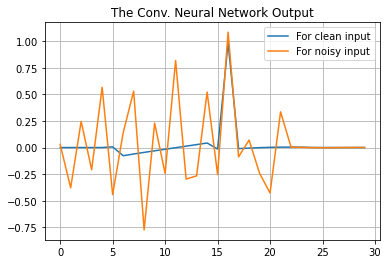

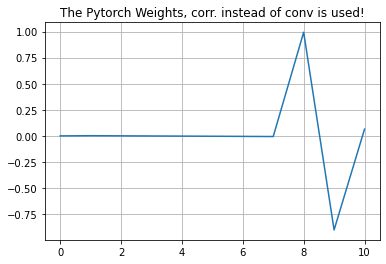

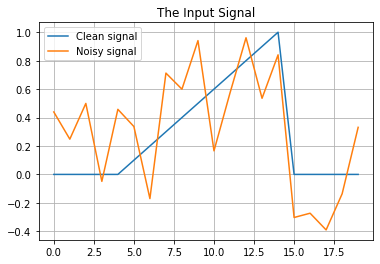

In [22]:
print("Y=", Y)
plt.figure()
plt.plot()
plt.plot(Ydet[0,0,:])
plt.plot(Ydetnoisy[0,0,:])
plt.legend(('For clean input', 'For noisy input'))
plt.title('The Conv. Neural Network Output')
plt.grid()
plt.figure()
plt.plot(weights[0].data.numpy()[0,0,:])
plt.title('The Pytorch Weights, corr. instead of conv is used!')
plt.grid()
plt.figure()
plt.plot(x)
plt.plot(xnoisy)
plt.legend(('Clean signal', 'Noisy signal'))
plt.title('The Input Signal')
plt.grid()

The figure shows the obtained weights or coefficients, in pytorch they are used as correlation instead of convolution, and hence the plot is a **time-reversed** impulse response.

Observe that it looks indeed different from our matched filter, which was simply the (time-reversed) ramp signal. This is because the optimization also tries to minimized the output outside the detection time point.

The result of the detection for the clean and noisy signals.

Observe the peak at the detection time point is indeed much **more narrow** than for the matched filter!

### An Audio Predictor

We also use the mean squared error as minimization criterion or "loss function". In this case this does not differ from the target of the closed form formulation, and hence we obtain almost the same solution. Here, the desired target signal Y is
the audio input signal X, but 1 sample in the future,

```python
X=audio[:-L] #remove last samples (conv makes it longer again)
Y=audio[1:] #remove first sample, for the signal to predict, 1 sample  in the future.
```

In [23]:
# -*- coding: utf-8 -*-
__author__ = 'Gerald Schuller'
__copyright__ = 'G.S.'

"""
Simple program to use a convolutional neural network to obtain a prective coder,
using explicit inputs to layers, to enable skip layers.
According to: https://keras.io/getting-started/functional-api-guide/
With Pytorch
For instance according to WCLMS or prediction Boosting
Gerald Schuller, November 2018.
""";
# Ported to Jupyter Notebook by Renato Profeta, October 2020

In [24]:
import torch
import torch.nn as nn

import numpy as np
import matplotlib.pyplot as plt
import sys
import librosa
  
if sys.version_info[0] < 3:
   # for Python 2
   import cPickle as pickle
else:
   # for Python 3
   import pickle

L=12 #filter length
dilation=1 #Dilation: upsampling the filter impulse response, new filter length: (L-1)*dilation+1

In [25]:
def format_vector2pytorch(vector):
    #Function to convert a vector, like a mono audio signal, into a 3-d Tensor X that Keras expects
    #Tensor X with shape (batch, signal):
    #https://discuss.pytorch.org/t/confused-about-tensor-dimensions-and-batches/4761
    X = np.expand_dims(vector, axis=0)  #add batch dimension (here only 1 batch)
    X = np.expand_dims(X, axis=0)
    X=torch.from_numpy(X)
    X=X.type(torch.Tensor)
    return X

In [26]:
class ConvNet(nn.Module):
    def __init__(self):
        super(ConvNet, self).__init__()
        # Define the model. 
        self.layer1=nn.Sequential(nn.Conv1d(in_channels=1, out_channels=1, kernel_size=L, stride=1, 
                                            dilation=dilation, padding=dilation*(L-1), bias=False))
        #https://pytorch.org/docs/stable/nn.html#conv1d  
        # Generate a convolutional neural network model, 1 layer, no bias, linear activation function 
        # returns: Trainable object
        #concatenate data:
        #https://discuss.pytorch.org/t/concatenate-layer-output-with-additional-input-data/20462
        #input of layer: x, output of layer: out
    def forward(self, x):
        out = self.layer1(x)
        return out

Generate Model:
Input X.shape= torch.Size([1, 1, 99988])
Target Y.shape= torch.Size([1, 1, 99999])


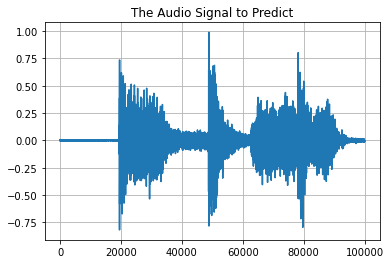

In [27]:
#Example to find prediction coefficients to minimize the mean absolute error using Python Keras
#and 1 Convolutional layer as a predictor.

import librosa
#Input mono audio signal X:
audio, samplerate = librosa.load("./audio/ACDC - Back In Black Intro.wav", sr=None, offset=6)
#samplerate, audio = wav.read("mspeech.wav")
#samplerate, audio = wav.read("fspeech.wav")
#samplerate, audio = wav.read("WCLMSprederror.wav")
#audio=audio*1.0/2**15 #normalize
audio=audio*1.0/np.max(np.abs(audio)) #normalize
    
audiosh=audio[:100000] #shorten the signal for faster optimization,
#audiosh=audio[46750:47750]
plt.figure()
plt.plot(audiosh)
plt.title("The Audio Signal to Predict")
plt.grid()

    
X=format_vector2pytorch(audiosh[:-((L-1)*dilation+1)])      #remove last samples 
Y=format_vector2pytorch(audiosh[1:]) #remove first sample, for the signal to predict, 1 sample in the future
    
print("Generate Model:")
print("Input X.shape=", X.shape )
print("Target Y.shape=", Y.shape)

import IPython.display as ipd
display(ipd.Audio(audiosh, rate=samplerate));


In [28]:
print("Generate Model:")
#model = generate_model()     # Compile an neural net
model = ConvNet()#.to('cpu')
print("Def. loss function:")
loss_fn = nn.MSELoss(reduction='sum')
#learning_rate = 1e-4
optimizer = torch.optim.Adam(model.parameters())#, lr=learning_rate)

Generate Model:
Def. loss function:


In [29]:
for epoch in range(6000):
    Ypred=model(X)
    loss=loss_fn(Ypred, Y)
    if epoch%100==0:
        print(epoch, loss.item())
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

0 1956.305419921875
100 510.977783203125
200 371.20220947265625
300 320.4161071777344
400 278.0284423828125
500 243.89768981933594
600 216.94369506835938
700 195.73956298828125
800 178.9434051513672
900 165.44375610351562
1000 154.39126586914062
1100 145.17337036132812
1200 137.3612060546875
1300 130.65321350097656
1400 124.82937622070312
1500 119.72085571289062
1600 115.1923828125
1700 111.13360595703125
1800 107.45436096191406
1900 104.08207702636719
2000 100.95926666259766
2100 98.04132080078125
2200 95.29419708251953
2300 92.69224548339844
2400 90.21613311767578
2500 87.85137939453125
2600 85.58699798583984
2700 83.41462707519531
2800 81.32769775390625
2900 79.3209228515625
3000 77.38990783691406
3100 75.53083801269531
3200 73.74030303955078
3300 72.01514434814453
3400 70.352294921875
3500 68.74873352050781
3600 67.20149993896484
3700 65.70763397216797
3800 64.26423645019531
3900 62.86833953857422
4000 61.517127990722656
4100 60.207801818847656
4200 58.937713623046875
4300 57.70432

In [30]:
torch.save({'epoch': epoch,
       'model_state_dict': model.state_dict(),
       'optimizer_state_dict': optimizer.state_dict()}, "linpredweights.torch")

In [31]:
#Processing full length signal:
X=format_vector2pytorch(audio[:-((L-1)*dilation+1)])  #remove last samples 
Y=format_vector2pytorch(audio[1:]) #remove first sample
predictions=model(X) # Make Predictions based on the obtained weights, on short audio
#mean squared predicton error:
err= sum((predictions[0,0,:]-Y[0,0,:])**2)/max(Y.shape)
print("mean squared prediction error=", err)
#mean signal power:
sigpow=sum(X[0,0,:]**2)/max(X.shape)
print("mean signal power=", sigpow)
print("Signal to Error Power Ratio:", sigpow/err)
    
ww = model.state_dict()   #read obtained weights
print("ww=", ww)
#weight format for Conv1d:
#[0: filter weights, 1: bias for first layer]
#weight: filters of shape: out_channels× in_channelsgroups× kW
weights=ww['layer1.0.weight'][0,0,:]
    
    
print("weights= ", weights)
#print("Predictions[0,0,:]= ", predictions[0,0,:])

mean squared prediction error= tensor(0.0004, grad_fn=<DivBackward0>)
mean signal power= tensor(0.0125)
Signal to Error Power Ratio: tensor(30.2955, grad_fn=<DivBackward0>)
ww= OrderedDict([('layer1.0.weight', tensor([[[ 0.0055,  0.0481, -0.0521,  0.0699, -0.0266, -0.0698,  0.1921,
          -0.3197,  0.3119,  0.0493, -0.8160,  1.5775]]]))])
weights=  tensor([ 0.0055,  0.0481, -0.0521,  0.0699, -0.0266, -0.0698,  0.1921, -0.3197,
         0.3119,  0.0493, -0.8160,  1.5775])


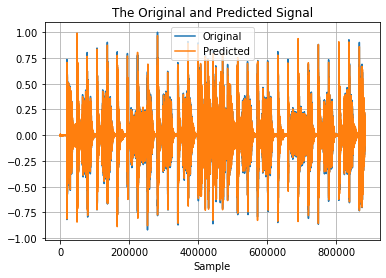

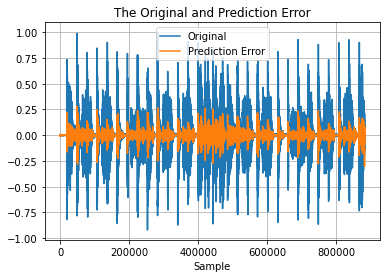

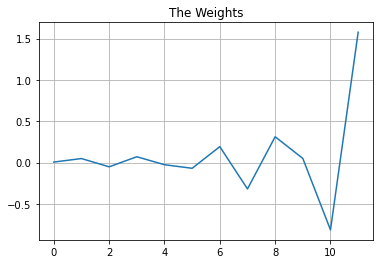

In [32]:
#print("Y=",Y)
#convert to numpy:
#https://discuss.pytorch.org/t/how-to-transform-variable-into-numpy/104/2
#plt.plot(np.array(Y[0,0,:]))
#plt.show()
plt.figure()
plt.plot(np.array(Y[0,0,:]))
plt.plot(predictions.detach().numpy()[0,0,:])
plt.legend(('Original','Predicted'))
plt.title('The Original and Predicted Signal')
plt.xlabel('Sample')
plt.grid()
plt.figure()
plt.plot(np.array(Y[0,0,:]))
plt.plot(predictions.detach().numpy()[0,0,:]-np.array(Y[0,0,:]))
plt.legend(('Original','Prediction Error'))
plt.title('The Original and Prediction Error')
plt.xlabel('Sample')
plt.grid()
plt.figure()
plt.plot(np.array(weights))
plt.title('The Weights')
plt.grid()


In [33]:
ipd.Audio(predictions.detach().numpy()[0,0,:], rate=samplerate)

### Exercise:

Design a sampling rate up-converter, for an audio signal sampled at 8 kHz to a sampling rate of 32 kHz. For the training, generate the 8 kHz version by low pass filtering and downsampling a 32 kHz version, for instance from: https://freesound.org/

Design the low pass filter as described e.g. in lecture ADSP, part 8. Also upsample it using this filter. Listen to the upsampled result. Does it have audible artifacts? If so, then there is not enough stopband attenuation (it should be at least 60 dB from passband to stopband).

Then use a convolutional neural network to interpolate the missing samples. Use the autoencoder decoder structure of the next set of slides. Train it on the audio signals, 8 kHz sample version as the input, the 32kHz original as target.

Compare the result with the traditional upsampler using the lowpass filter. Try to obtain better sounding results from the neural network.

# Convolutional Autoencoder

A so-called Autoencoder is a neural network with unsupervised training, which means that we don't need to supply a target function. There is only a training set, which is also the target set. A convolutional autoencoder uses convolutional neural networks. 

An autoencoder maps the input signal to a lower dimensional representation using its encoder part. In this way it is similar for instance to an audio encoder, which compresses an audio signal into a representation with fewer bits than the original audio signal:

The decoder part of an autoencoder maps the lower dimensional representation back into the higher dimensional representation. This is similar to an audio decoder, which decodes the compressed version back to an audio signal.

The reconstruction after the decoder part should be as close as possible to the original. Hence the original (the training set) is also the target.

In our Python example we simply use one 1D convolutional layer for the encoder. This corresponds to the analysis filter bank of an audio encoder.

But here we also use an activation function, the "tanh" function, which seems to work better than the sigmoid function in this application, probably because it keeps the signs. We use a "stride" or downsampling factor of N=1024, and filter kernels of size 2N. 

To obtain the same dimension as the input at the encoder output, which is a critical sampled filter bank, we need N filters, or N "out_channels".

But because we want to reduce the dimensionality after encoding, we choose a lower number, which makes it an over-critically sampled filter bank, for instance "out_channels=32". This is similar to an audio coder where we simply drop the filter subbands with the highest frequencies.

We still have to choose the "padding", meaning the number of zeros which we pad before and after our audio signal before the convolution (or rather correlation in Pytorch). To align the output of the decoder with the input signal for the case of symmetric filter kernels (impulse responses), we need a padding of *filter-length/2-1*, or *kernel_size/2-1)*, because then the filtering starts with the first sample at the center of the filter, which corresponds to the the position where the filter outputs the correspondingly filtered sample, for both encoder and decoder.

Hence in Python our encoder convolutional layer example becomes:

```python
self.conv1=nn.Conv1d(in_channels=1, out_channels=32, 
                     kernel_size=2048, stride=1024, padding=1023, 
                     bias=True) #Padding for 'same' filters (kernel_size/2-1)
```

Observe that we have 1 input channel (the audio signal), and 32 output channels (the subbands).

For the decoder part we need a synthesis filter bank, which in neural network literature is also called a transposed convolutional layer, in pytorch "ConvTranspose1d":

```python
self.synconv1=nn.ConvTranspose1d(in_channels=32, out_channels=1, 
                                 kernel_size=2048, stride=1024, padding=1023, bias=True)
```

Observe that for this synthesis filter bank we have 32 input channels (the subbands) and 1 output channel (the reconstructed audio signal).

The function for the encoder is now:

```python
def encoder(self, x):
    #Analysis:
    x = self.conv1(x)
    y = torch.tanh(x)
    return y
```

Observe that here we included the tanh activation function, which can also be seen as a range limiter (between -1 and 1).

For the decoder it is:

```python
def decoder(self, y):
    #Synthesis:
    xrek= self.synconv1(y)
    return xrek
```

For both together it becomes the overall autoencoder:

```python
def forward(self, x):
    y=self.encoder(x)
    #y=torch.round(y/0.125)*0.125
    xrek=self.decoder(y)
    return xrek
```

We put these functions in a class "Convautoenc":

```python
class Convautoenc(nn.Module):
```

For the training we use the input signal also as a target. There we have to limit the length to the signal length produced by the model output, which we can simply obtain by letting the model run once before the training:

```python
model = Convautoenc()
Ypred=model(X)
outputlen=len(Ypred[0,0,:])
Y=X[:,:,:outputlen]
```

Y is the target signal with same length as model output.

As loss function a common choice is the Mean Squared Error, even though it might not be optimal:

```python
loss_fn = nn.MSELoss()
```

The training is then done with with the for loop:

```python
for epoch in range(2000):
    Ypred=model(X)
    loss=loss_fn(Ypred, Y)
    if epoch%10==0:
        print(epoch, loss.item())
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()
```

In [34]:
# -*- coding: utf-8 -*-
__author__ = 'Gerald Schuller'
__copyright__ = 'G.S.'

"""
convolutional autoencoder for audio signals.
Gerald Schuller, February 2020.
""";
#Ported to Jupyter Notebooks by Renato Profeta, October 2020

In [35]:
import torch
import torch.nn as nn
import torch.nn.functional as F

import numpy as np
import matplotlib.pyplot as plt
import sys
import os
import librosa

In [36]:
if sys.version_info[0] < 3:
   # for Python 2
   import cPickle as pickle
else:
   # for Python 3
   import pickle
   
# Device configuration
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print("device=", device) 

device= cpu


In [37]:
def signal2pytorch(x):
    #Function to convert a signal vector x, like a mono audio signal, into a 3-d Tensor that conv1d of Pytorch expects,
    #https://pytorch.org/docs/stable/nn.html
    #Argument x: a 1-d signal as numpy array
    #input x[batch,sample]
    #output: 3-d Tensor X for conv1d input.
    #for conv1d Input: (N,Cin,Lin), Cin: numer of input channels (e.g. for stereo), Lin: length of signal, N: number of Batches (signals) 
    X = np.expand_dims(x, axis=0)  #add channels dimension (here only 1 channel)
    if len(x.shape)==1: #mono:
        X = np.expand_dims(X, axis=0)  #add batch dimension (here only 1 batch)
    X=torch.from_numpy(X)
    X=X.type(torch.Tensor)
    X=X.permute(1,0,2)  #make batch dimension first
    return X

In [38]:
class Convautoenc(nn.Module):
    def __init__(self):
        super(Convautoenc, self).__init__()
        #Analysis Filterbank with downsampling of N=1024, filter length of 2N, but only N/2 outputs:
        self.conv1=nn.Conv1d(in_channels=1, out_channels=32, kernel_size=2048, stride=1024, padding=1023, bias=True) #Padding for 'same' filters (kernel_size/2-1)

        #Synthesis filter bank:
        self.synconv1=nn.ConvTranspose1d(in_channels=32, out_channels=1, kernel_size=2048, stride=1024, padding=1023, bias=True)

    def encoder(self, x):
        #Analysis:
        x = self.conv1(x)
        y = torch.tanh(x)
        return y
      
    def decoder(self, y):
        #Synthesis:
        xrek= self.synconv1(y)
        return xrek
      
    def forward(self, x):
        y=self.encoder(x)
        #y=torch.round(y/0.125)*0.125
        xrek=self.decoder(y)
        return xrek

In [39]:
#alternative: speech:
batch=1
audio, samplerate = librosa.load("./audio/ACDC - Back In Black Intro.wav", mono=False, sr=None, offset=6)
audio[0,:]/=np.abs(audio[0,:]).max()
audio[1,:]/=np.abs(audio[1,:]).max()
X_train=signal2pytorch(audio[0,:]).to(device) #Convert to pytorch format, batch is first dimension    
X_test=signal2pytorch(audio[1,:]).to(device) #Convert to pytorch format, batch is first dimension    

In [40]:
print("Generate Model:")
model = Convautoenc().to(device)
print('Total number of parameters: %i' % (sum(p.numel() for p in model.parameters() if p.requires_grad)))
print("Def. loss function:")
loss_fn = nn.MSELoss()  #MSE
#loss_fn = nn.L1Loss()
    
Ypred=model(X_train)
   
#Ypred=Ypred.detach()
outputlen=len(Ypred[0,0,:]) #length of the signal at the output of the network.
print("outputlen=", outputlen)
    
Y=X_train[:,:,:outputlen]  #the target signal with same length as model output
    
print("Input X.shape=", X_train.shape )
print("Target Y.shape=", Y.shape)
print("Target Y=", Y)
#print("max(max(Y))=", max(max(max(Y))))
#print("min(min(Y))=", min(min(min(Y))))
print("Y.type()=", Y.type())

Generate Model:
Total number of parameters: 131105
Def. loss function:
outputlen= 881666
Input X.shape= torch.Size([1, 1, 882000])
Target Y.shape= torch.Size([1, 1, 881666])
Target Y= tensor([[[-0.0021,  0.0010,  0.0031,  ..., -0.0969, -0.0991, -0.0316]]])
Y.type()= torch.FloatTensor


In [41]:
learning_rate = 1e-4
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)#, betas=(0.9, 0.999))
"""
try:
    checkpoint = torch.load("audio_autoenc.torch",map_location='cpu')
    model.load_state_dict(checkpoint['model_state_dict'])
    #optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
except IOError:
    print("fresh start")
""";
    
#optimrandomdir_pytorch.optimizer(model, loss_fn, X, Ypred, iterations=300, startingscale=1.0, endscale=0.0)
Ypred=model(X_train)
#Ypred=Ypred.detach()
print("Ypred=", Ypred)
    
#randdir=True # True for optimization of random direction, False for pytorch optimization
randdir=False
    
if randdir==True:
#optimization of weights using method of random directions:
    optimrandomdir_pytorch.optimizer(model, loss_fn, X_train, Y, iterations=100000, startingscale=0.25, endscale=0.0)
    #--End optimization of random directions------------------------
else:
    for epoch in range(10000):
        Ypred=model(X_train)
        #print("Ypred.shape=", Ypred.shape)
        #loss wants batch in the beginning! (Batch, Classes,...)
        #Ypredp=Ypred.permute(1,2,0)
        #Yp=Y.permute(1,0)
        #print("Ypredp.shape=", Ypredp.shape, "Yp.shape=", Yp.shape )
        loss=loss_fn(Ypred, Y)
        if epoch%10==0:
            print(epoch, loss.item())
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

Ypred= tensor([[[-0.0131, -0.0152, -0.0148,  ..., -0.0088, -0.0149, -0.0123]]],
       grad_fn=<SqueezeBackward1>)
0 0.013093843124806881
10 0.012846099212765694
20 0.012438016012310982
30 0.011813707649707794
40 0.011097315698862076
50 0.010418813675642014
60 0.009818931110203266
70 0.009311183355748653
80 0.008886918425559998
90 0.008521264418959618
100 0.00819743424654007
110 0.00790864322334528
120 0.007652008440345526
130 0.0074239373207092285
140 0.0072198836132884026
150 0.007035492919385433
160 0.006866879295557737
170 0.0067107114009559155
180 0.006564327050000429
190 0.0064256745390594006
200 0.0062932465225458145
210 0.006166066508740187
220 0.006043554283678532
230 0.005925487261265516
240 0.005811814218759537
250 0.00570259802043438
260 0.005597899202257395
270 0.0054977405816316605
280 0.005402099806815386
290 0.005310897249728441
300 0.005223988089710474
310 0.005141204688698053
320 0.005062328651547432
330 0.004987140651792288
340 0.0049154008738696575
350 0.00484687555

3100 0.0028427382931113243
3110 0.002842162037268281
3120 0.0028415897395461798
3130 0.0028410200029611588
3140 0.0028404544573277235
3150 0.0028398893773555756
3160 0.0028393305838108063
3170 0.002838773187249899
3180 0.0028382190503180027
3190 0.0028376674745231867
3200 0.002837121021002531
3210 0.0028365759644657373
3220 0.002836033469066024
3230 0.0028354960959404707
3240 0.002834959886968136
3250 0.0028344271704554558
3260 0.0028338972479104996
3270 0.002833371516317129
3280 0.0028328471817076206
3290 0.002832327038049698
3300 0.0028318078257143497
3310 0.0028312935028225183
3320 0.0028307815082371235
3330 0.002830272074788809
3340 0.0028297663666307926
3350 0.0028292618226259947
3360 0.002828761236742139
3370 0.002828262746334076
3380 0.002827766351401806
3390 0.0028272748459130526
3400 0.002826786832883954
3410 0.002826299285516143
3420 0.002825813600793481
3430 0.0028253323398530483
3440 0.0028248548042029142
3450 0.002824376802891493
3460 0.002823904389515519
3470 0.0028234329

6190 0.0027518225833773613
6200 0.0027516745030879974
6210 0.0027515364345163107
6220 0.002751398365944624
6230 0.002751267747953534
6240 0.0027512265369296074
6250 0.002751031192019582
6260 0.0027508886996656656
6270 0.002750739920884371
6280 0.0027506076730787754
6290 0.0027504758909344673
6300 0.002750346204265952
6310 0.002750216517597437
6320 0.002750085899606347
6330 0.002749956212937832
6340 0.002749834442511201
6350 0.0027497850824147463
6360 0.002749592997133732
6370 0.002749499399214983
6380 0.0027493294328451157
6390 0.0027491950895637274
6400 0.002749070292338729
6410 0.0027489447966217995
6420 0.0027488216292113066
6430 0.0027487666811794043
6440 0.0027485850732773542
6450 0.0027484626043587923
6460 0.0027483340818434954
6470 0.002748207887634635
6480 0.002748085418716073
6490 0.002747965045273304
6500 0.0027478435076773167
6510 0.002747757127508521
6520 0.0027476365212351084
6530 0.0027475040405988693
6540 0.0027473685331642628
6550 0.002747246762737632
6560 0.00274712895

9290 0.0027265986427664757
9300 0.0027263774536550045
9310 0.0027262733783572912
9320 0.002726175356656313
9330 0.0027261311188340187
9340 0.002726086415350437
9350 0.0027260396163910627
9360 0.0027259953785687685
9370 0.0027259495109319687
9380 0.0027259045746177435
9390 0.0027258608024567366
9400 0.002725815400481224
9410 0.0027257767505943775
9420 0.002725752769038081
9430 0.002726046135649085
9440 0.0027258675545454025
9450 0.002725636586546898
9460 0.0027255674358457327
9470 0.0027255218010395765
9480 0.0027254719752818346
9490 0.002725430065765977
9500 0.0027253865264356136
9510 0.0027253443840891123
9520 0.00272530154325068
9530 0.0027252589352428913
9540 0.0027252165600657463
9550 0.0027251741848886013
9560 0.0027251320425421
9570 0.0027251385618001223
9580 0.0027251257561147213
9590 0.002725055208429694
9600 0.002724983496591449
9610 0.002724934136494994
9620 0.0027248894330114126
9630 0.0027248444966971874
9640 0.002724805846810341
9650 0.0027248235419392586
9660 0.0027248642

ww= OrderedDict([('conv1.weight', tensor([[[-0.0496,  0.0105,  0.0147,  ..., -0.0935, -0.0667,  0.1039]],

        [[-0.0108, -0.1029, -0.0605,  ...,  0.0168, -0.0230, -0.0729]],

        [[ 0.0544,  0.0444, -0.0195,  ..., -0.0658, -0.0539, -0.0398]],

        ...,

        [[-0.0189,  0.0067,  0.1000,  ..., -0.0836, -0.1273, -0.0463]],

        [[-0.0009, -0.0433, -0.1271,  ...,  0.0329, -0.0018, -0.0174]],

        [[ 0.0170, -0.0041, -0.0005,  ...,  0.0342,  0.0125,  0.0120]]])), ('conv1.bias', tensor([ 1.3229e-03, -4.3025e-05, -4.8720e-04, -3.5504e-04,  7.7248e-05,
         2.3070e-04, -5.1290e-04, -4.0245e-04,  1.5536e-03,  6.3199e-04,
        -7.1482e-06, -3.1192e-04,  7.9546e-04,  2.8009e-03, -7.5687e-04,
         7.5215e-04,  4.8194e-04,  1.3284e-03, -7.2328e-04,  1.6882e-04,
         1.1504e-04, -1.7151e-03, -5.8697e-04, -2.8304e-04,  1.6959e-03,
        -8.5591e-04,  1.4378e-03, -1.2060e-04, -2.3271e-03,  1.3574e-03,
         1.0414e-03,  1.9514e-03])), ('synconv1.weight', te

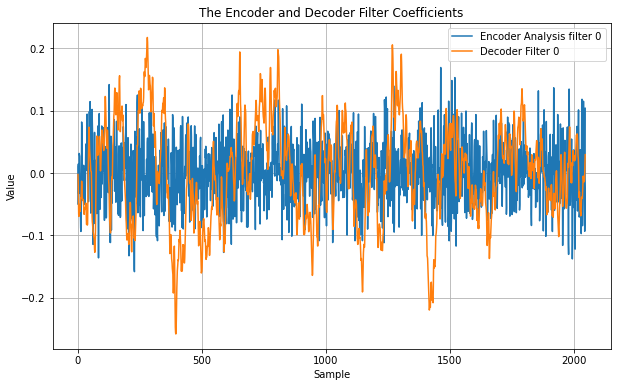

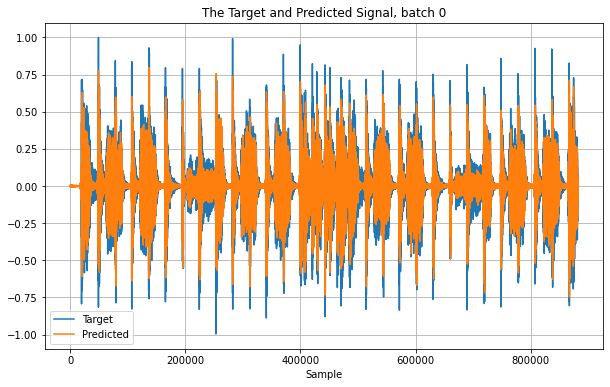

In [42]:
"""
torch.save({#'epoch': epoch,
    'model_state_dict': model.state_dict(),
    'optimizer_state_dict': optimizer.state_dict()}, "audio_autoenc.torch")
"""
    
ww = model.state_dict()   #read obtained weights
print("ww=", ww)
#Plot obtained weights:
plt.figure(figsize=(10,6))
plt.plot(np.transpose(np.array(ww['conv1.weight'][0:1,0,:])))
plt.plot(np.transpose(np.array(ww['synconv1.weight'][0:1,0,:])))
plt.legend(('Encoder Analysis filter 0', 'Decoder Filter 0'))
plt.xlabel('Sample')
plt.ylabel('Value')
plt.title('The Encoder and Decoder Filter Coefficients')
plt.grid()

#Test on training set:
predictions=model(X_train).cpu() # Make Predictions based on the obtained weights, on training set
predictions=predictions.detach()
predictions=np.array(predictions)
Y=np.array(Y) #target
#print("Y=",Y)
print("predictions.shape=", predictions.shape)
#convert to numpy:
#https://discuss.pytorch.org/t/how-to-transform-variable-into-numpy/104/2
#Plot target signal and output of autoencoder:
plt.figure(figsize=(10,6))
for b in range(batch):
    plt.plot(np.array(Y[b,0,:]))
    plt.plot(predictions[b,0,:])
    plt.legend(('Target','Predicted'))
    plt.title('The Target and Predicted Signal, batch '+str(b))
    plt.xlabel('Sample')
    plt.grid()
xrek=predictions[:,0,:]  #remove unnecessary dimension for playback
#xrek=np.transpose(xrek)
#xrek=np.clip(xrek, -1.0,1.0)

In [43]:
import IPython.display as ipd
display(ipd.Audio(xrek, rate=samplerate));

Observe that here the difference is clearly big.

Observe that it is very noisy.

In this way, the autoencoder can be seen as a kind of a filter. It learns a low dimensional subspace from the training set. Every new input is mapped onto this subspace. If it doesn't quite fit onto this subspace, major elements might be missing.

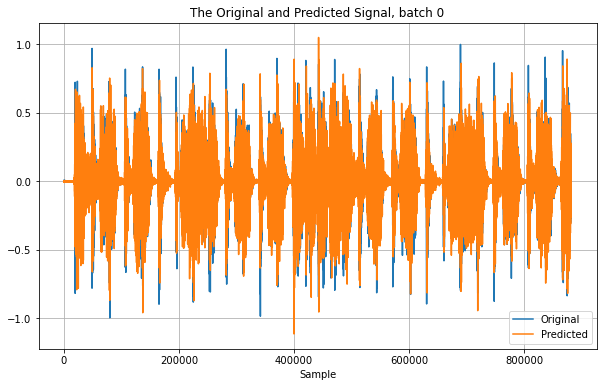

In [44]:
#Test on Verification set:
predictions=model(X_test).cpu() # Make Predictions based on the obtained weights, on verification set
predictions=predictions.detach()
predictions=np.array(predictions)
plt.figure(figsize=(10,6))
for b in range(batch):
    plt.plot(np.array(X_test[b,0,:]))
    plt.plot(predictions[b,0,:])
    plt.legend(('Original','Predicted'))
    plt.title('The Original and Predicted Signal, batch '+str(b))
    plt.xlabel('Sample')
    plt.grid()
xrek=predictions[:,0,:]

In [45]:
display(ipd.Audio(xrek, rate=samplerate));

## Effects of Signal Shifts

Observe the stride we used in our autoencoder. The stride corresponds to the down and up-sampling rate of the corresponding filter bank. This sampling together with the convolution has the effect of processing the signal in blocks of size of the stride. 

If we now shift our input signal by prepending the number of stride zeros at the beginning (hence delaying it by "stride" samples), we will get the same blocks, just one block later. But if we prepend a number of zeros which is not an integer multiple of the stride, the blocks will look different, and hence the result will look different, not just shifted.

In our example we can observe this by testing the trained autoencoder first with **100 zeros** added at the beginning of the training signal. The output appears **noisy**.

In [46]:
#Test on shifted input:
X_train_shifted_100 = nn.ConstantPad1d(100, 0)(X_train)
predictions=model(X_train_shifted_100).cpu() # Make Predictions based on the obtained weights, on verification set
predictions=predictions.detach()
predictions=np.array(predictions)
xrek=predictions[:,0,:]

In [47]:
display(ipd.Audio(xrek, rate=samplerate));

Then we add **1024 zeros** at the beginning of the signal. The output is a **bit more clear** again.

In [48]:
#Test on 1024 samples shifted test set (shift identical to the stride size)
X_train_shifted_1024 = nn.ConstantPad1d(1024, 0)(X_train)
predictions=model(X_train_shifted_1024).cpu() # Make Predictions based on the obtained weights, on verification set
predictions=predictions.detach()
predictions=np.array(predictions)
xrek=predictions[:,0,:]

In [49]:
display(ipd.Audio(xrek, rate=samplerate));

# Denoising Autoencoder

The "Denoising Autoencoder" is basically the same as an Autoencoder, but instead of having a clean audio signal as its input, it has a noisy version.

Usually this noisy version has added noise, but it could also be other kinds of distortions.

The goal of the denoising Autoencoder is then to reconstruct the clean version of its input. Hence it is trained on noisy signals as trainings set. To avoid that the denoising Autoencoder learns a specific instance of the noise, an new instance of the noise is generated for each epoch of the training process.

So for our example we use the same autoencoder structure as before, and train it with an added noise.

The training 'for' loop then contains:
```python
Ypred=model(X+torch.randn(X.size())*0.05)```

To make it shift invariant, we can also include a cyclic ("round robin") shift as another type of distortion in the trainings loop, for the input X and the target Y:

```python
Xlast=X[:,:,-1].clone()
X[:,:,1:]=X[:,:,:-1].clone()
#round Robbin, shift 1 right
X[:,:,0]=Xlast.clone()
Ylast=Y[:,:,-1].clone()
Y[:,:,1:]=Y[:,:,:-1].clone()
#round Robbin, shift 1 right
Y[:,:,0]=Ylast.clone()```

The training then continues as usual with:
```python
Ypred=model(X)
loss=loss_fn(Ypred, Y)
if epoch%10==0:
    print(epoch, loss.item())
optimizer.zero_grad()
loss.backward()
optimizer.step()```

## Experiment 1 with stride=512 

In [50]:
# -*- coding: utf-8 -*-
__author__ = 'Gerald Schuller'
__copyright__ = 'G.S.'

"""
convolutional autoencoder for audio signals.
Gerald Schuller, February 2020.
""";
# Ported to Jupyter Notebook by Renato Profeta, November 2020

In [51]:
import torch
import torch.nn as nn
import torch.nn.functional as F

import numpy as np
import matplotlib.pyplot as plt
import sys
import os
import librosa

In [52]:
if sys.version_info[0] < 3:
   # for Python 2
   import cPickle as pickle
else:
   # for Python 3
   import pickle
    
# Device configuration
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print("device=", device) 

device= cpu


In [53]:
def signal2pytorch(x):
    #Function to convert a signal vector x, like a mono audio signal, into a 3-d Tensor that conv1d of Pytorch expects,
    #https://pytorch.org/docs/stable/nn.html
    #Argument x: a 1-d signal as numpy array
    #input x[batch,sample]
    #output: 3-d Tensor X for conv1d input.
    #for conv1d Input: (N,Cin,Lin), Cin: numer of input channels (e.g. for stereo), Lin: length of signal, N: number of Batches (signals) 
    X = np.expand_dims(x, axis=0)  #add channels dimension (here only 1 channel)
    if len(x.shape)==1: #mono:
        X = np.expand_dims(X, axis=0)  #add batch dimension (here only 1 batch)
    X=torch.from_numpy(X)
    X=X.type(torch.Tensor)
    X=X.permute(1,0,2)  #make batch dimension first
    return X

In [54]:
class Convautoenc(nn.Module):
    def __init__(self):
        super(Convautoenc, self).__init__()
        #Analysis Filterbank with downsampling of N=1024, filter length of 2N, but only N/2 outputs:
        self.conv1=nn.Conv1d(in_channels=1, out_channels=32, kernel_size=2048, stride=512, padding=1023, bias=True) #Padding for 'same' filters (kernel_size/2-1)

        #Synthesis filter bank:
        self.synconv1=nn.ConvTranspose1d(in_channels=32, out_channels=1, kernel_size=2048, stride=512, padding=1023, bias=True)

    def encoder(self, x):
        #Analysis:
        x = self.conv1(x)
        y = torch.tanh(x)
        return y
      
    def decoder(self, y):
        #Synthesis:
        xrek= self.synconv1(y)
        return xrek
      
    def forward(self, x):
        y=self.encoder(x)
        #y=torch.round(y/0.125)*0.125
        xrek=self.decoder(y)
        return xrek

In [55]:
batch=1
audio, samplerate = librosa.load("./audio/ACDC - Back In Black Intro.wav", mono=False, sr=None, offset=6)
audio[0,:]/=np.abs(audio[0,:]).max()
audio[1,:]/=np.abs(audio[1,:]).max()
X_train=signal2pytorch(audio[0,:]).to(device) #Convert to pytorch format, batch is first dimension    
X_test=signal2pytorch(audio[1,:]).to(device) #Convert to pytorch format, batch is first dimension    

In [56]:
print("Generate Model:")
model = Convautoenc().to(device)
print('Total number of parameters: %i' % (sum(p.numel() for p in model.parameters() if p.requires_grad)))
print("Def. loss function:")
loss_fn = nn.MSELoss()  #MSE
#loss_fn = nn.L1Loss()
    
Ypred=model(X_train)
   
#Ypred=Ypred.detach()
outputlen=len(Ypred[0,0,:]) #length of the signal at the output of the network.
print("outputlen=", outputlen)
    
Y=X_train[:,:,:outputlen]  #the target signal with same length as model output
    
print("Input X.shape=", X_train.shape )
print("Target Y.shape=", Y.shape)
print("Target Y=", Y)
#print("max(max(Y))=", max(max(max(Y))))
#print("min(min(Y))=", min(min(min(Y))))
print("Y.type()=", Y.type())

Generate Model:
Total number of parameters: 131105
Def. loss function:
outputlen= 881666
Input X.shape= torch.Size([1, 1, 882000])
Target Y.shape= torch.Size([1, 1, 881666])
Target Y= tensor([[[-0.0021,  0.0010,  0.0031,  ..., -0.0969, -0.0991, -0.0316]]])
Y.type()= torch.FloatTensor


In [57]:
learning_rate = 1e-4
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)#, betas=(0.9, 0.999))
"""
try:
    checkpoint = torch.load("audio_autoenc.torch",map_location='cpu')
    model.load_state_dict(checkpoint['model_state_dict'])
    #optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
except IOError:
    print("fresh start")
""";
    
#optimrandomdir_pytorch.optimizer(model, loss_fn, X, Ypred, iterations=300, startingscale=1.0, endscale=0.0)
Ypred=model(X_train)
#Ypred=Ypred.detach()
print("Ypred=", Ypred)
    
#randdir=True # True for optimization of random direction, False for pytorch optimization
randdir=False
    
if randdir==True:
#optimization of weights using method of random directions:
    optimrandomdir_pytorch.optimizer(model, loss_fn, X_train, Y, iterations=100000, startingscale=0.25, endscale=0.0)
    #--End optimization of random directions------------------------
else:
    for epoch in range(4000):
        #distortions: shift and noise:
        #"""
        Xlast=X_train[:,:,-1].clone() 
        X_train[:,:,1:]=X_train[:,:,:-1].clone() #round Robbin, shift 1 right
        X_train[:,:,0]=Xlast.clone()
        Ylast=Y[:,:,-1].clone() 
        Y[:,:,1:]=Y[:,:,:-1].clone() #round Robbin, shift 1 right
        Y[:,:,0]=Ylast.clone()
        #"""
        Ypred=model(X_train+torch.randn(X_train.size())*0.05)
        #print("Ypred.shape=", Ypred.shape)
        #loss wants batch in the beginning! (Batch, Classes,...)
        #Ypredp=Ypred.permute(1,2,0)
        #Yp=Y.permute(1,0)
        #print("Ypredp.shape=", Ypredp.shape, "Yp.shape=", Yp.shape )
        loss=loss_fn(Ypred, Y)
        if epoch%10==0:
            print(epoch, loss.item())
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

Ypred= tensor([[[ 8.3139e-06, -2.4689e-03, -8.8102e-04,  ..., -5.0312e-03,
          -5.5650e-03, -1.2817e-02]]], grad_fn=<SqueezeBackward1>)
0 0.012956772930920124
10 0.012505732476711273
20 0.011792563833296299
30 0.010830752551555634
40 0.009912082925438881
50 0.009204793721437454
60 0.008649284020066261
70 0.008204714395105839
80 0.007863658480346203
90 0.007582813501358032
100 0.007321764249354601
110 0.007120379712432623
120 0.006922311615198851
130 0.006730822380632162
140 0.006559146102517843
150 0.006411378271877766
160 0.006270887330174446
170 0.0061376141384243965
180 0.006000039633363485
190 0.005867517087608576
200 0.00576429907232523
210 0.005661375820636749
220 0.005552986636757851
230 0.005452876910567284
240 0.005372412037104368
250 0.005292844958603382
260 0.005205915775150061
270 0.0051229544915258884
280 0.005052054300904274
290 0.004992505069822073
300 0.00492964219301939
310 0.004876904189586639
320 0.0048275659792125225
330 0.004774653352797031
340 0.004718352109

3100 0.002820580266416073
3110 0.002827440155670047
3120 0.002824140479788184
3130 0.0028189504519104958
3140 0.002820019144564867
3150 0.002811179496347904
3160 0.0028267623856663704
3170 0.002815350191667676
3180 0.0028153941966593266
3190 0.002817129250615835
3200 0.0028083128854632378
3210 0.0028199884109199047
3220 0.0028232482727617025
3230 0.002816931577399373
3240 0.0028158884961158037
3250 0.002818526467308402
3260 0.002820037305355072
3270 0.0028118696063756943
3280 0.002820407971739769
3290 0.0028135443571954966
3300 0.0028062586206942797
3310 0.0028122395742684603
3320 0.0028220852836966515
3330 0.0028300974518060684
3340 0.002822896232828498
3350 0.002820726251229644
3360 0.002813531318679452
3370 0.002808777615427971
3380 0.002817610278725624
3390 0.002824736526235938
3400 0.0028223395347595215
3410 0.0028178486973047256
3420 0.0028242911212146282
3430 0.0028152992017567158
3440 0.002806438133120537
3450 0.00281856139190495
3460 0.002819118555635214
3470 0.002816211665049

ww= OrderedDict([('conv1.weight', tensor([[[-1.9932e-03, -4.9128e-03, -9.0273e-03,  ..., -5.2193e-03,
           9.1794e-04,  5.6037e-03]],

        [[ 9.5604e-03,  3.0853e-03, -2.6868e-03,  ...,  6.7587e-04,
          -2.5353e-03, -6.1236e-03]],

        [[-1.4820e-02, -1.1285e-02, -1.1674e-02,  ...,  1.0215e-02,
           6.2549e-03,  2.3305e-03]],

        ...,

        [[-1.4363e-03,  6.5101e-03,  9.7733e-03,  ...,  3.4276e-03,
           3.9997e-03,  7.0556e-03]],

        [[-3.4055e-03, -4.5613e-05,  2.2336e-03,  ..., -2.4182e-03,
          -9.3388e-03, -1.9154e-02]],

        [[ 9.5867e-03,  4.2829e-03, -1.0376e-03,  ..., -2.5032e-04,
          -1.0953e-03,  3.0616e-03]]])), ('conv1.bias', tensor([ 3.3792e-04, -9.2047e-05, -1.0425e-04,  1.8158e-05,  3.8751e-04,
        -9.8056e-05,  3.3346e-04,  2.0659e-04,  7.4696e-05,  3.1077e-04,
        -1.4361e-04,  1.7729e-04, -3.5420e-04, -1.3936e-04, -4.4290e-04,
        -1.9860e-05, -1.0095e-04, -2.2170e-04,  2.9573e-04, -3.7881e-04,
 

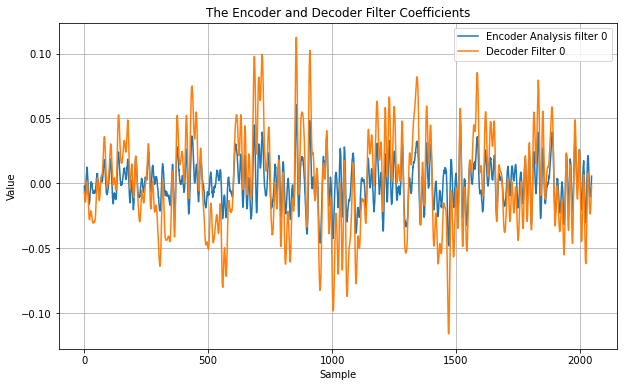

In [58]:
"""
torch.save({#'epoch': epoch,
    'model_state_dict': model.state_dict(),
    'optimizer_state_dict': optimizer.state_dict()}, "audio_autoenc.torch")
"""
    
ww = model.state_dict()   #read obtained weights
print("ww=", ww)
#Plot obtained weights:
plt.figure(figsize=(10,6))
plt.plot(np.transpose(np.array(ww['conv1.weight'][0:1,0,:])))
plt.plot(np.transpose(np.array(ww['synconv1.weight'][0:1,0,:])))
plt.legend(('Encoder Analysis filter 0', 'Decoder Filter 0'))
plt.xlabel('Sample')
plt.ylabel('Value')
plt.title('The Encoder and Decoder Filter Coefficients')
plt.grid()

predictions.shape= (1, 1, 881666)


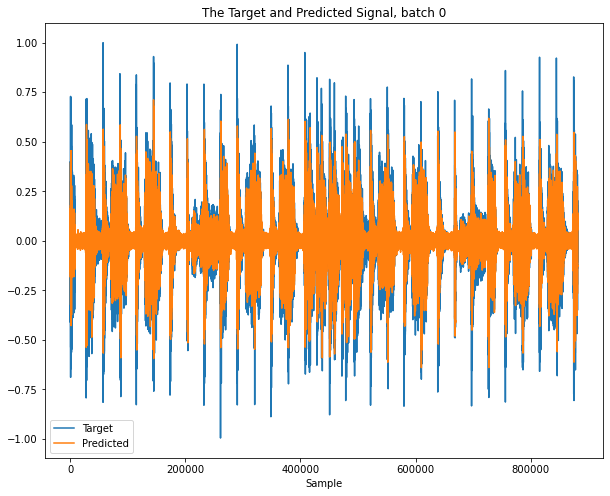

In [59]:
#Test on training set:
Xnoise=(X_train+torch.randn(X_train.size())*0.05)
#Xnoise=torch.cat((torch.zeros(1,1,100), Xnoise),dim=-1)
predictions=model(Xnoise).cpu() # Make Predictions based on the obtained weights, on training set
predictions=predictions.detach()
predictions=np.array(predictions)
Y=np.array(Y) #target
#print("Y=",Y)
print("predictions.shape=", predictions.shape)
#convert to numpy:
#https://discuss.pytorch.org/t/how-to-transform-variable-into-numpy/104/2
#Plot target signal and output of autoencoder:
plt.figure(figsize=(10,8))
for b in range(batch):
    plt.plot(np.array(Y[b,0,:]))
    plt.plot(predictions[b,0,:])
    plt.legend(('Target','Predicted'))
    plt.title('The Target and Predicted Signal, batch '+str(b))
    plt.xlabel('Sample')
    plt.show()

Xnoise=Xnoise.detach()
Xnoise=np.array(Xnoise)
xnoise=Xnoise[:,0,:]
#xnoise=np.transpose(xnoise)
#xnoise=np.clip(xnoise, -1.0,1.0)
    
xrek=predictions[:,0,:]  #remove unnecessary dimension for playback
#xrek=np.transpose(xrek)
#xrek=np.clip(xrek, -1.0,1.0)

    
 

In [60]:
import IPython.display as ipd
display(ipd.Audio(xnoise, rate=samplerate));

In [61]:
import IPython.display as ipd
display(ipd.Audio(xrek, rate=samplerate));

Observe that there is now a bigger difference to the original. 

Observe that the reconstructed version sounds very muffled.

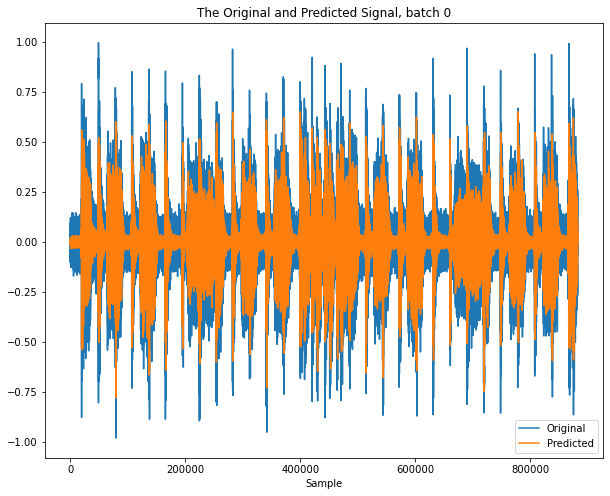

In [62]:
#Test on Verification set:
X_test_shifted_100 = nn.ConstantPad1d(100, 0)(X_test)
x=X_test_shifted_100+torch.from_numpy((np.random.normal(scale=0.04, size=X_test_shifted_100.shape))).float()
predictions=model(x).cpu() # Make Predictions based on the obtained weights, on verification set
predictions=predictions.detach()
predictions=np.array(predictions)

plt.figure(figsize=(10,8))
for b in range(batch):
    plt.plot(np.array(x[b,0,:]))
    plt.plot(predictions[b,0,:])
    plt.legend(('Original','Predicted'))
    plt.title('The Original and Predicted Signal, batch '+str(b))
    plt.xlabel('Sample')
    plt.show()
xrek=predictions[:,0,:]

In [63]:
display(ipd.Audio(x[:,0,:], rate=samplerate));

In [64]:
display(ipd.Audio(xrek, rate=samplerate));

**Observe** that here the difference is similar. 

**Observe** that it is similarly muffled. 

At least the shift sensitivity is not there because of the way we trained it.

## Expriment 2 with Reduced stride=32

To obtain a better audio quality we now reduce the stride (the downsampling and upsampling factor) to 32.

In [65]:
class Convautoenc(nn.Module):
    def __init__(self):
        super(Convautoenc, self).__init__()
        #Analysis Filterbank with downsampling of N=1024, filter length of 2N, but only N/2 outputs:
        self.conv1=nn.Conv1d(in_channels=1, out_channels=32, kernel_size=2048, stride=32, padding=1023, bias=True) #Padding for 'same' filters (kernel_size/2-1)

        #Synthesis filter bank:
        self.synconv1=nn.ConvTranspose1d(in_channels=32, out_channels=1, kernel_size=2048, stride=32, padding=1023, bias=True)

    def encoder(self, x):
        #Analysis:
        x = self.conv1(x)
        y = torch.tanh(x)
        return y
      
    def decoder(self, y):
        #Synthesis:
        xrek= self.synconv1(y)
        return xrek
      
    def forward(self, x):
        y=self.encoder(x)
        #y=torch.round(y/0.125)*0.125
        xrek=self.decoder(y)
        return xrek

In [66]:
batch=1
audio, samplerate = librosa.load("./audio/ACDC - Back In Black Intro.wav", mono=False, sr=None, offset=6)
audio[0,:]/=np.abs(audio[0,:]).max()
audio[1,:]/=np.abs(audio[1,:]).max()
X_train=signal2pytorch(audio[0,:]).to(device) #Convert to pytorch format, batch is first dimension    
X_test=signal2pytorch(audio[1,:]).to(device) #Convert to pytorch format, batch is first dimension    

In [67]:
print("Generate Model:")
model = Convautoenc().to(device)
print('Total number of parameters: %i' % (sum(p.numel() for p in model.parameters() if p.requires_grad)))
print("Def. loss function:")
loss_fn = nn.MSELoss()  #MSE
#loss_fn = nn.L1Loss()
    
Ypred=model(X_train)
   
#Ypred=Ypred.detach()
outputlen=len(Ypred[0,0,:]) #length of the signal at the output of the network.
print("outputlen=", outputlen)
    
Y=X_train[:,:,:outputlen]  #the target signal with same length as model output
    
print("Input X.shape=", X_train.shape )
print("Target Y.shape=", Y.shape)
print("Target Y=", Y)
#print("max(max(Y))=", max(max(max(Y))))
#print("min(min(Y))=", min(min(min(Y))))
print("Y.type()=", Y.type())

Generate Model:
Total number of parameters: 131105
Def. loss function:
outputlen= 881986
Input X.shape= torch.Size([1, 1, 882000])
Target Y.shape= torch.Size([1, 1, 881986])
Target Y= tensor([[[-0.0021,  0.0010,  0.0031,  ...,  0.0486,  0.0698,  0.1591]]])
Y.type()= torch.FloatTensor


In [69]:
learning_rate = 1e-4
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)#, betas=(0.9, 0.999))
"""
try:
    checkpoint = torch.load("audio_autoenc.torch",map_location='cpu')
    model.load_state_dict(checkpoint['model_state_dict'])
    #optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
except IOError:
    print("fresh start")
""";
    
#optimrandomdir_pytorch.optimizer(model, loss_fn, X, Ypred, iterations=300, startingscale=1.0, endscale=0.0)
Ypred=model(X_train)
#Ypred=Ypred.detach()
print("Ypred=", Ypred)
    
#randdir=True # True for optimization of random direction, False for pytorch optimization
randdir=False
    
if randdir==True:
#optimization of weights using method of random directions:
    optimrandomdir_pytorch.optimizer(model, loss_fn, X_train, Y, iterations=100000, startingscale=0.25, endscale=0.0)
    #--End optimization of random directions------------------------
else:
    for epoch in range(40):
        #distortions: shift and noise:
        #"""
        Xlast=X_train[:,:,-1].clone() 
        X_train[:,:,1:]=X_train[:,:,:-1].clone() #round Robbin, shift 1 right
        X_train[:,:,0]=Xlast.clone()
        Ylast=Y[:,:,-1].clone() 
        Y[:,:,1:]=Y[:,:,:-1].clone() #round Robbin, shift 1 right
        Y[:,:,0]=Ylast.clone()
        #"""
        Ypred=model(X_train+torch.randn(X_train.size())*0.05)
        #print("Ypred.shape=", Ypred.shape)
        #loss wants batch in the beginning! (Batch, Classes,...)
        #Ypredp=Ypred.permute(1,2,0)
        #Yp=Y.permute(1,0)
        #print("Ypredp.shape=", Ypredp.shape, "Yp.shape=", Yp.shape )
        loss=loss_fn(Ypred, Y)
        if epoch%10==0:
            print(epoch, loss.item())
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

Ypred= tensor([[[ 0.0002, -0.0017,  0.0045,  ..., -0.0008, -0.0367, -0.0318]]],
       grad_fn=<SqueezeBackward1>)
0 0.006814784836024046
10 0.005340927746146917
20 0.00440769549459219
30 0.0037643664982169867


First you will notice that it trains or optimizes much slower, because it has to process more data.

ww= OrderedDict([('conv1.weight', tensor([[[ 0.0022,  0.0038,  0.0148,  ..., -0.0039,  0.0108,  0.0027]],

        [[ 0.0190,  0.0051,  0.0123,  ..., -0.0088,  0.0031,  0.0070]],

        [[-0.0061, -0.0126,  0.0027,  ...,  0.0027, -0.0048,  0.0127]],

        ...,

        [[ 0.0068, -0.0002, -0.0181,  ...,  0.0195, -0.0073,  0.0182]],

        [[-0.0067, -0.0111, -0.0245,  ..., -0.0033,  0.0180,  0.0184]],

        [[-0.0006, -0.0023,  0.0102,  ...,  0.0097,  0.0097,  0.0206]]])), ('conv1.bias', tensor([ 0.0191, -0.0075, -0.0211,  0.0106,  0.0182,  0.0080, -0.0155, -0.0113,
        -0.0014, -0.0134, -0.0185, -0.0063, -0.0137,  0.0211,  0.0070,  0.0171,
         0.0228,  0.0179,  0.0157,  0.0180,  0.0085, -0.0047, -0.0005, -0.0018,
         0.0143,  0.0104,  0.0098, -0.0008,  0.0033,  0.0152,  0.0113,  0.0217])), ('synconv1.weight', tensor([[[-0.0092, -0.0255,  0.0025,  ..., -0.0018,  0.0153, -0.0228]],

        [[ 0.0108,  0.0177, -0.0177,  ..., -0.0061, -0.0049,  0.0213]],

        

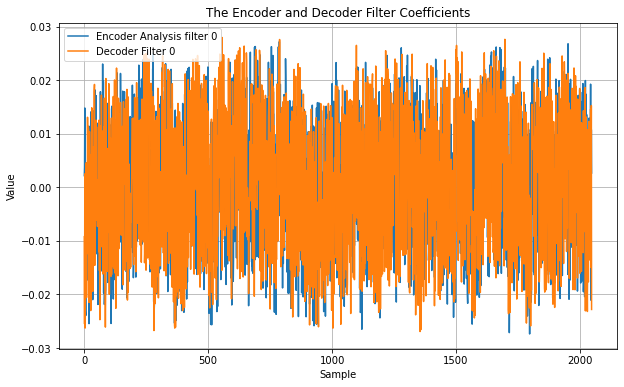

In [70]:
"""
torch.save({#'epoch': epoch,
    'model_state_dict': model.state_dict(),
    'optimizer_state_dict': optimizer.state_dict()}, "audio_autoenc.torch")
"""
    
ww = model.state_dict()   #read obtained weights
print("ww=", ww)
#Plot obtained weights:
plt.figure(figsize=(10,6))
plt.plot(np.transpose(np.array(ww['conv1.weight'][0:1,0,:])))
plt.plot(np.transpose(np.array(ww['synconv1.weight'][0:1,0,:])))
plt.legend(('Encoder Analysis filter 0', 'Decoder Filter 0'))
plt.xlabel('Sample')
plt.ylabel('Value')
plt.title('The Encoder and Decoder Filter Coefficients')
plt.grid()

predictions.shape= (1, 1, 881986)


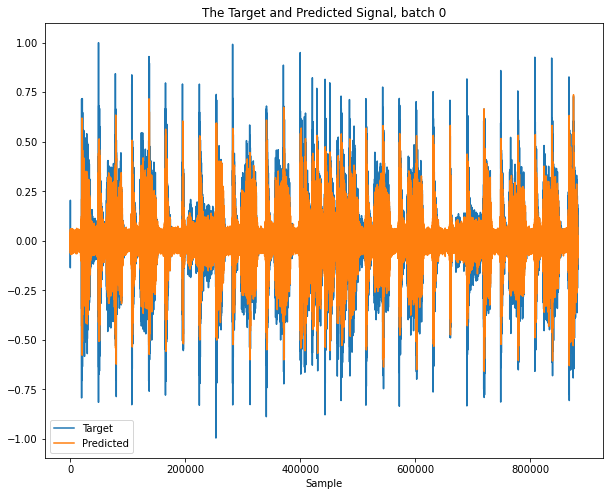

In [71]:
#Test on training set:
Xnoise=(X_train+torch.randn(X_train.size())*0.05)
#Xnoise=torch.cat((torch.zeros(1,1,100), Xnoise),dim=-1)
predictions=model(Xnoise).cpu() # Make Predictions based on the obtained weights, on training set
predictions=predictions.detach()
predictions=np.array(predictions)
Y=np.array(Y) #target
#print("Y=",Y)
print("predictions.shape=", predictions.shape)
#convert to numpy:
#https://discuss.pytorch.org/t/how-to-transform-variable-into-numpy/104/2
#Plot target signal and output of autoencoder:
plt.figure(figsize=(10,8))
for b in range(batch):
    plt.plot(np.array(Y[b,0,:]))
    plt.plot(predictions[b,0,:])
    plt.legend(('Target','Predicted'))
    plt.title('The Target and Predicted Signal, batch '+str(b))
    plt.xlabel('Sample')
    plt.show()

Xnoise=Xnoise.detach()
Xnoise=np.array(Xnoise)
xnoise=Xnoise[:,0,:]
#xnoise=np.transpose(xnoise)
#xnoise=np.clip(xnoise, -1.0,1.0)
    
xrek=predictions[:,0,:]  #remove unnecessary dimension for playback
#xrek=np.transpose(xrek)
#xrek=np.clip(xrek, -1.0,1.0)

    
 

In [72]:
import IPython.display as ipd
display(ipd.Audio(xnoise, rate=samplerate));

In [73]:
import IPython.display as ipd
display(ipd.Audio(xrek, rate=samplerate));

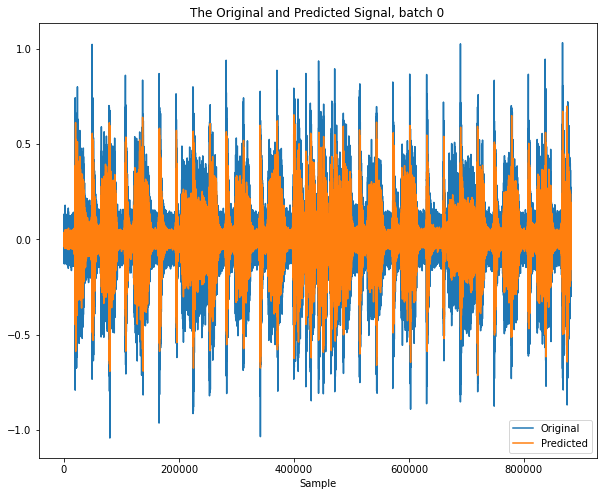

In [74]:
#Test on Verification set:
X_test_shifted_100 = nn.ConstantPad1d(100, 0)(X_test)
x=X_test_shifted_100+torch.from_numpy((np.random.normal(scale=0.04, size=X_test_shifted_100.shape))).float()
predictions=model(x).cpu() # Make Predictions based on the obtained weights, on verification set
predictions=predictions.detach()
predictions=np.array(predictions)

plt.figure(figsize=(10,8))
for b in range(batch):
    plt.plot(np.array(x[b,0,:]))
    plt.plot(predictions[b,0,:])
    plt.legend(('Original','Predicted'))
    plt.title('The Original and Predicted Signal, batch '+str(b))
    plt.xlabel('Sample')
    plt.show()
xrek=predictions[:,0,:]

In [75]:
display(ipd.Audio(x[:,0,:], rate=samplerate));

In [76]:
display(ipd.Audio(xrek, rate=samplerate));

But when it finally plays back the reconstructed versions of the training and verification set, you can hear that the signals indeed sound a bit better, less muffled!

This shows the effect of the stride: Too low means long training, too high means less quality.

# Recurrent Neural Networks

So far we saw networks that process the input in layers towards the output, but with no feedback path. 

Recurrent Neural Networks (RNN), compute an internal "state" from the input, which then becomes part of the input in the next time-step. This makes it similar to Infinite Impulse Response (IIR) linear filters, which have a feedback path via delay elements from their output back to their input, as depicted in the following picture:


<center>
    <br>
 <img src="./images/iir_filter.jpg" width="700" />
    <br>
 </center>
 
This is a generic IIR filter (from: Lecture "Advanced Digital Signal Processing", slides 7, https://www.tu-ilmenau.de/mt/lehrveranstaltungen/lehre-fuer-master-mt/adsp-digital-signal-procesing-2, or: Alan V. Oppenheim, Ronald W. Schafer, with John R. Buck: "Discrete-Time Signal Processing" ).

We first analyse this structure, and then we will try to implement it with a **Recurrent Neural Network.**

The coefficients $b_i$ are the feed-forward coefficients, the $a_i$ are the feed-back coefficients. x[n] is the(audio) input signal, y[n] is the output signal of the filter. 

Because of the feedback path the IIR filter can start to oscillate and even become unstable.

This happens if the poles of its transfer function in the z-domain are outside the unit-circle. But if the poles are just inside the unit circle, and close to it, this filter produces an impulse response of decaying oscillations or sinusoidal signals. 

As an audio signal, this can sound like a tone from a bell. In this way it can be used to generate a signal.

The corresponding difference equation in the time domain is:

$$\large
\begin{equation}
y[n]= \sum _{m=0} ^L b[m] \cdot x[n-m]+ \sum _ {r=1} ^R a[r] \cdot y(n-r)
\end{equation}$$    

(See also: Oppenheim, Schafer: “Discrete Time Signal Processing”, Chapter 6 in Ed. 1989)

The resulting transfer function in the z-domain is (see also the lecture above):

$$ \large
H(z)=\dfrac{Y(z)}  {X(z)}= \dfrac{\sum _ {m=0} ^L b(m)  \cdot z^{-m}}{1-\sum _ {r=1} ^ R a(r) \cdot z^{-r}}
$$

For our test generative example we would like to have a decaying sinusoidal function as impulse response. 

We get this from a simple $2^{nd}$ order IIR filter, with $b_0=1$ (and 0 else, L=1), and R=2, meaning just 2 feedback delays and coefficients.

$$\large
\begin{equation}
y[n]= x[n] + \sum _{r=1}^2 a[r] \cdot y[n-r]
\end{equation}$$

and results in the transfer function in the z-domain:

$$ \large
H(z)=\dfrac{1}  {1-a_1\cdot z^{-1}-a_2\cdot z^{-2}}
$$

The denominator polynomial is of order 2, and hence has 2 zeros, which result in 2 poles, $p_0$, $p_1$ , of the transfer function H(z).

Each pole causes an oscillation at a frequency which is given by its angle to the real axis, in radians (where $\pi$ is 180 degrees), interpreted as normalized frequency (where $2\pi$ corresponds to the sampling frequency). If we want a real valued oscillation, we need a **conjugate complex pole pair.**

### **Example:** 
We want a decaying oscillation as an impulse response, with a frequency of 440 Hz (which is musical pitch A), at a sampling frequency of 8000 samples per second, and a decay factor of Q=0.995 per sample. The normalized frequency is then:

$$\large
\Omega=\dfrac{2\pi\cdot 440 Hz}{8000 Hz}$$

Then the conjugate complex pole pair is:

$$\large
p_{0,1}=Q \cdot \exp\left(\pm j \cdot Q\right)$$

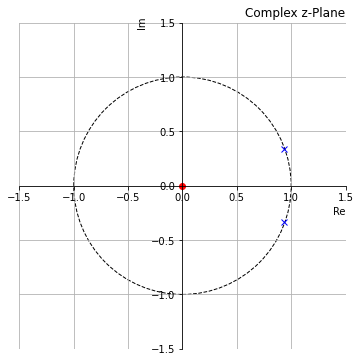

In [77]:
import numpy as np
import matplotlib.pyplot as plt
Q=0.995
Omega= 2*np.pi*440/8000
p0 = Q*np.exp(1j*Omega)
p1 = Q*np.exp(-1j*Omega)
# Plot Poles and Zeros
from  matplotlib import patches
plt.figure(figsize=(8,6))
ax = plt.subplot(111)
r = 1.5; plt.axis('scaled'); plt.axis([-r, r, -r, r])
#ticks = [-1, 1]; plt.xticks(ticks); plt.yticks(ticks)
# Unit Circle
uc = patches.Circle((0,0), radius=1, fill=False, color='black', ls='dashed')
ax.add_patch(uc)
ax.spines['left'].set_position('center')
ax.spines['bottom'].set_position('center')
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
plt.xlabel('Re', horizontalalignment='right', x=1.0)
plt.ylabel('Im',  y=1.0)
plt.title('Complex z-Plane', loc='right')
plt.grid()
plt.plot(0,0,'ro')
plt.plot(np.real(p0),np.imag(p0),'bx')
plt.plot(np.real(p1),np.imag(p1),'bx')

With these poles, the transfer function becomes:

$$ \large
H(z)=\dfrac{1}  {1-a_1\cdot z^{-1}-a_2\cdot z^{-2}} =\dfrac{1}  {(1-p_0\cdot z^{-1})(1-p_1\cdot z^{-1})} 
$$

which means:

$$\large
a_1=(p_0+p_1) \\
\large
a_2=p_0\cdot p_1$$

using the above pole pair (and with Eulers formula $e^{j\cdot \Omega}=\cos (\omega)+ j\cdot \sin(\Omega)$ ) this becomes:

$$\large
a_1=2Q\cdot \cos(\Omega)\\
\large
a_2=-Q^2$$

### Python Implementation

In Python we first create an impulse, meaning a one (or 0.1 to keep the signal smaller), followed by as many zeros as we would like to produce the impulse response. Then we use `scipy.signal.lfilter` to generate the impulse response. 

There we need to observe that `lfilter` expects the "a" coefficients (here "k" coefficients) with opposite sign.

In [78]:
from scipy import signal as sig
Fs=8000
seq_len=Fs*2
omega=2*np.pi*440.0 /Fs
k1=2*Q*np.cos(omega)
k2=-pow(Q,2);
ximp=np.zeros(seq_len) #make impulse with a desired sequence length
ximp[0]=0.1 #impulse at the beginning
filtered=sig.lfilter([1], np.array([1, -k1,-k2]), ximp)

It then plays back the resulting impulse response to the audio output:

In [79]:
import IPython.display as ipd
ipd.Audio(filtered, rate=Fs)

Observe that it indeed sounds like a small bell or a Xylophone.

## Implementation using a Recurrent Neural Network (RNN)

In IIR filters we have the delay chain of delay elements $z^{−1}$ , which delay each sample by one sample interval. 

In an RNN instead we have the "hidden states" *h*, which is a vector or array which is updated after each sample interval according  to the matrix equation:

$$\large
h_t=tanh(W_{ih}\cdot  x_t+b_{ih}+W_{hh}\cdot h_{t−1}+b_{hh})$$

where $x_t$ is our input signal (here the impulse), and *t* is our integer valued time index (which was *n* for the IIR filter). The *W* are weight matrices, and the *b* are the biases, which we don't need here.

Observe that *x* and *h* are column vectors or arrays.

Also, there is always a non-linearity. Default is the `tanh function`, an alternative is the `relu` function.

In [80]:
%%html
<iframe width="900" height="400" src="https://pytorch.org/docs/stable/generated/torch.nn.RNN.html#torch.nn.RNN"></iframe>

Since our IIR filter does not have a non-linearity, we choose the *tanh* function and keep the signal small,  such that it stays in its more linear region.

The hidden state *h* also represents the output of the RNN.

To make it function like our *IIR filter*, we use the hidden states as the delay line in our IIR filter, which means the hidden states are equal to the filter output and its two delayed versions:

$$\large
h_t[i]=y[t−i] \text{ for i=0,1,2}$$

hence i=0 denotes the most recent sample.

Observe the notation $h_t[i]$: this is an array or (column) vector with 3 entries, indexed with *i* , at time *t* .

From the time domain difference eq. (2) we know that:

$$\large
h_t[0]=y[t]=x[t]+a_1 \cdot y[t−1] + a_2 \cdot y[t−2]$$

which equals:

$$\large
h_t[0]=x[t]+a_1 \cdot h_{t−1} [0]+a_2 \cdot h_{t−1} [1] $$

Then we just need to shift the remaining hidden states by one time step down such that they become the delay line:

$$\large
h_t[1]=h_{t−1}[0] \\
\large
h_t [2]=h_{t−1}[1] $$

These equations now give us the necessary weight matrices $W_{hh}$ and $W_{ih}$ , in our simplified RNN update equation:

$$\large
h_t=W_{ih} \cdot x_t+W_{hh} \cdot h_{t−1}$$

where we neglected the non-linear activation function and set the biases to zero.

We get:

$$\large
W_{hh}=
\begin{bmatrix}
a_1 & a_2 & 0\\
1 & 0 & 0 \\
0 & 1 & 0
\end{bmatrix}$$

We set $x_t$ as the single sample x[t] (instead of a column vector, since we don't need past *x* values because we chose no FIR part with L=0 in eq. (1)), hence $W_{ih}$ just becomes a column weight vector which has a 1 in the position for $h_t[0]$:

$$\large
W_{ih}=
\begin{bmatrix}
 1\\
0 \\
0
\end{bmatrix}$$

This is now our RNN working as our IIR filter!

The output of our RNN IIR filter is $h_t[0]$ , which we obtain by adding a linear output layer, which has a factor of 1 for this element, and zeros for the other elements.

### Python Pytorch Implementation

We use Pytorch to implement a Recurrent Neural Network (RNN) as a class:

In [81]:
import torch
import torch.nn as nn
# Device configuration
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print("device=", device)  

infeatures= 1 # samples per input time step
hiddensize= 3 #number of hidden states, the memory elements
outputs=1 #1 samples per output time step
numlayers=1 #number of layers of the network
batch=1

device= cpu


In [82]:
class RNNnet(nn.Module):
    def __init__(self, infeatures, hiddensize, outputs):
        super(RNNnet, self).__init__()
        # Define the model.
        self.rnn = nn.RNN(input_size=infeatures, hidden_size=hiddensize, num_layers=numlayers, bias=False)
        #forward layer for output
        self.fo = nn.Linear(hiddensize, outputs, bias=False)
        
    def forward(self, x):
        h_0 = torch.zeros(numlayers, batch, hiddensize).to(device)
        out, hn = self.rnn(x, h_0)
        #Output is simply the hidden state of the last layer (if more than 1 layer)
        out = self.fo(out) #e.g. used to just keep first output
        return out

To convert our audio signal to the Pytorch format for the RNN, we define the function:

In [83]:
def signal2pytorch(x):
    #Function to convert a signal vector x, like a mono audio signal, into a 3-d Tensor that Pytorch expects,
    #https://pytorch.org/docs/stable/nn.html
    #Argument x: a 1-d signal as numpy array
    #output: 3-d Pytorch Tensor.
    #for RNN Input: (siglen,batch,features)
    X = np.expand_dims(x, axis=-1) #add batch dimension (here only 1 )
    X = np.expand_dims(X, axis=-1) #add features dimension (here only 1 )
    X=torch.from_numpy(X)
    X=X.type(torch.Tensor)
    return X

Next we compute the coefficients for our IIR filter:

In [84]:
import numpy as np
Fs=8000
omega=2*np.pi*440.0 /Fs; #normalized frequency
Q=0.995 #determines speed of decay, the closer to 1 the longer
k1=2*Q*np.cos(omega)
k2=-pow(Q,2);

Then we compute its impulse response and play it to the speaker:

In [85]:
from scipy import signal as sig
import IPython.display as ipd
seq_len=Fs*2
ximp=np.zeros(seq_len) #make impulse with a desired sequence length
ximp[0]=0.1 #impulse at the beginning
filtered=sig.lfilter([1], np.array([1, -k1,-k2]), ximp)
print("The impulse response sound from the I.I.R. filter")
display(ipd.Audio(filtered, rate= Fs))

The impulse response sound from the I.I.R. filter


In [86]:
"""
RNN as IIR Filter: hidden states h as delay chain 
Weights for updating h for shifting the delay line:
s=array([[0,0,0],[1,0,0],[0,1,0]]) 
In [4]: s      
array([[0, 0, 0],
       [1, 0, 0],
       [0, 1, 0]])

Application of IIR coefficients a(1)=2, a(2)=3:
a=array([[1,2,3],[0,1,0],[0,0,1]])                                      

In [2]: a 
Out[2]: 
array([[1, 2, 3],
       [0, 1, 0],
       [0, 0, 1]])
First apply shift operator s and then coefficents, h multiplied from right:
dot(a,s)
array([[2, 3, 0],
       [1, 0, 0],
       [0, 1, 0]])
this is w_hh.
""";

Now we can create our neural network model and assign our desired weights, such that it acts like the IIR filter:

In [87]:
rnn = RNNnet(infeatures, hiddensize, outputs)
#Shifted diagonal matrix and IIR Filter coefficients:
rnn.state_dict()['rnn.weight_hh_l0'].data.copy_(torch.diag(torch.ones(hiddensize-1),diagonal=-1))
rnn.state_dict()['rnn.weight_hh_l0'][0,:].data.copy_(torch.tensor([ k1, k2,0.0]))
#Vector with a "1" for input x:
rnn.state_dict()['rnn.weight_ih_l0'].data.copy_(torch.zeros((hiddensize,1)))
rnn.state_dict()['rnn.weight_ih_l0'][0,0].data.copy_(torch.tensor(1.0))
#Weight for linear output layer to select h[0]:
rnn.state_dict()['fo.weight'][0,:].data.copy_(torch.tensor([1.0,0.0 ,0.0]))
ww = rnn.state_dict() #read obtained weights
print("weights =", ww)

weights = OrderedDict([('rnn.weight_ih_l0', tensor([[1.],
        [0.],
        [0.]])), ('rnn.weight_hh_l0', tensor([[ 1.8724, -0.9900,  0.0000],
        [ 1.0000,  0.0000,  0.0000],
        [ 0.0000,  1.0000,  0.0000]])), ('fo.weight', tensor([[1., 0., 0.]]))])


With this print function you should check at runtime if the weights of the model now look like you would expect. If they look okay we have now a functional neural network which should work similar to an IIR filter. We try it by converting our impulse input to Pytorch, and then feed it to our neural network:

In [88]:
#the input, converted from the Numpy array:
inputsig=signal2pytorch(ximp)
#Run Recurrent Neural Network:
outsig= rnn(inputsig)

The output of the RNN is then converted back to numpy, played back to the speaker for listening comparison, and ploted together with the output of the IIR filter for visual comparison:

In [89]:
outsig=outsig.detach()
outsig=np.array(outsig) #turn into numpy array
outsig=outsig[:,0,0]
print("The sound from the recurrent neural network")
display(ipd.Audio(outsig, rate=Fs))

The sound from the recurrent neural network


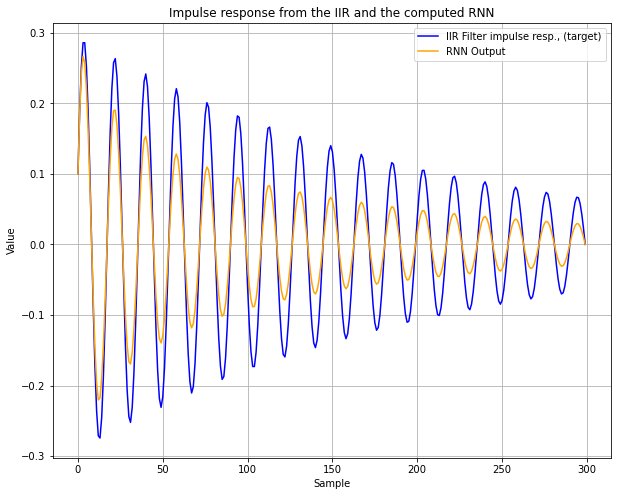

In [90]:
import matplotlib.pyplot as plt
plt.figure(figsize=(10,8))
plt.plot(filtered[:300], 'blue')
plt.plot(outsig[:300],'orange')
plt.legend(('IIR Filter impulse resp., (target)','RNN Output'))
plt.xlabel('Sample')
plt.ylabel('Value')
plt.title("Impulse response from the IIR and the computed RNN")
plt.grid()

The resulting plot below shows that the output from the RNN is somewhat smaller, because of the `tanh` function.

This shows that an RNN can be indeed be setup to function like an IIR filter. This creates a connection to IIR filters, and hence RNN can be viewed as their generalization.

## Training the RNN

Now we know that there is a solution for the weights that make the RNN behave similar to an IIR filter. In general we will not pre-compute the weights, but let the optimization figure it out on its own, given the impulse as training input desired impulse response as target signal.

If the optimization is powerful enough it should be able to find this solution. The problem here is that for a system with feedback, as the RNN, the gradient of the loss function for the optimization is difficult to compute.

Pytorch uses "Autograd" to compute the gradients of the loss function, see:

In [91]:
%%html
<iframe width="900" height="400" src="https://pytorch.org/tutorials/beginner/blitz/autograd_tutorial.html"></iframe>

https://towardsdatascience.com/pytorch-autograd-understanding-the-heart-of-pytorchs-magic-2686cd94ec95

The weights are of *type* `torch.tensor`, and the have the attribute `requires_grad=True.`

Pytorch then tracks all operations with them to be able to quickly do the gradient calculation using back-propagation (which is basically just another name of the chain-rule of differentiation). This is done with the `.backward()` step in the optimization
loop. The resulting gradient is then stored in the `.grad` attribute.

When we have a feed back loop, as in recurrent neural networks, we apply the network over and over again to its output. This can be seen as a very deep neural network, where each loop iteration is another layer with the same coefficients. 

Applying *back-propagation* means that we go back through all those layers or iterations, using the chain rule for the computation of the gradient. But each computation introduces computation errors, which then accumulate. 

If our impulse response signal decays very slowly, then we have significant components far back in history, which makes the computation of the gradient very inaccurate. 

This can also lead to the problem of vanishing gradients, where very small values are rounded to zero, or exploding gradients, which leads to "Not a Number" (NaN) errors.

Our example has an impulse response with significant values over several thousand samples, at Q=0.995, and it sill converges. 

But if we make it a little longer by increasing Q to Q=0.9995, then the optimization is no longer converging because of this problem.

Approaches to solve this problem are the "Gated Recurrent Networks" (GRU):

In [92]:
%%html
<iframe width="900" height="400" src="https://pytorch.org/docs/master/generated/torch.nn.GRU.html?highlight=gru#torch.nn.GRU"></iframe>

and the “Long Short Term Memory” network (LSTM), which have learn-able bypass connections ("gates"), which make the computation of the gradient more precise. 

But for problems where the simple RNN converges, it seems to converge faster, also because GRU and LSTM have many more weights to be optimized.

In [93]:
%%html
<iframe width="900" height="400" src="https://pytorch.org/docs/master/generated/torch.nn.LSTM.html?highlight=lstm#torch.nn.LSTM"></iframe>

To continue with our Python program, it re-initializes the RNN, with random starting values, prints the total number of parameters (weights and biases), and then starts the optimization with 500 epochs:

In [94]:
#input is the pulse, with the 0.1 in the beginning, target is the output of the IIR filter:
target= signal2pytorch(filtered)
print("target.type()=", target.type())
print("target=", target)

target.type()= torch.FloatTensor
target= tensor([[[ 1.0000e-01]],

        [[ 1.8724e-01]],

        [[ 2.5157e-01]],

        ...,

        [[-2.8209e-36]],

        [[-1.4916e-36]],

        [[ 0.0000e+00]]])


In [95]:
#random starting point as initialization:
rnn.state_dict()['rnn.weight_hh_l0'].data.copy_(torch.randn(hiddensize,hiddensize))
#rnn.state_dict()['rnn.weight_hh_l0'].data.copy_(torch.zeros(hiddensize,hiddensize))
rnn.state_dict()['rnn.weight_ih_l0'].data.copy_(torch.randn((hiddensize,1)))
#rnn.state_dict()['rnn.weight_ih_l0'].data.copy_(torch.zeros((hiddensize,1)))
#rnn.state_dict()['fo.weight'][0,:].data.copy_(torch.tensor([ 1.0, 0.0 ,0.0]))
#rnn.state_dict()['fo.weight'][0,:].data.copy_(torch.zeros(hiddensize))
rnn.state_dict()['fo.weight'][0,:].data.copy_(torch.randn(hiddensize))

tensor([-0.2185, -1.0542,  0.5094])

In [105]:
rnn = RNNnet(infeatures, hiddensize, outputs).to(device)
ww = rnn.state_dict() #read current weights
print("weights =", ww)
print('Total number of parameters: %i' % (sum(p.numel() for p
in rnn.parameters() if p.requires_grad)))
loss_fn = nn.MSELoss(reduction='sum')
#learning_rate = 1e-3
optimizer = torch.optim.Adam(rnn.parameters())
for epoch in range(500):
    Ypred=rnn(inputsig)
    loss=loss_fn(Ypred, target)
    if epoch%10==0:
        print(epoch, loss.item())
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

weights = OrderedDict([('rnn.weight_ih_l0', tensor([[-0.5772],
        [ 0.3022],
        [ 0.1274]])), ('rnn.weight_hh_l0', tensor([[ 0.1810, -0.3321,  0.0344],
        [ 0.2255,  0.5417, -0.0785],
        [ 0.2755, -0.5771,  0.0643]])), ('fo.weight', tensor([[-0.1084, -0.4569,  0.1908]]))])
Total number of parameters: 15
0 4.392476558685303
10 4.390369415283203
20 4.388584613800049
30 4.387079238891602
40 4.385771751403809
50 4.3845744132995605
60 4.383420944213867
70 4.382259845733643
80 4.381043434143066
90 4.37971305847168
100 4.378194808959961
110 4.3763933181762695
120 4.374175548553467
130 4.37134313583374
140 4.367586135864258
150 4.3624114990234375
160 4.355074882507324
170 4.344654560089111
180 4.330656051635742
190 4.314060688018799
200 4.2950544357299805
210 4.270440578460693
220 4.235385894775391
230 4.176943778991699
240 4.054832935333252
250 3.6553478240966797
260 1.3482122421264648
270 2.7920148372650146
280 2.996642589569092
290 3.0221009254455566
300 3.00304603576660

The loss usually starts at around 4.4, and ends at around 0.1, which looks successful. 

The program then plots the resulting impulse response from the RNN in comparison with the given audio target, which is the impulse response of the IIR filter:

In [106]:
#the input, converted from the Numpy array:
inputsig=signal2pytorch(ximp)
#Run Recurrent Neural Network:
outsig= rnn(inputsig)

In [107]:
outsig=outsig.detach()
outsig=np.array(outsig) #turn into numpy array
outsig=outsig[:,0,0]
print("The sound from the recurrent neural network")
display(ipd.Audio(outsig, rate=Fs))

The sound from the recurrent neural network


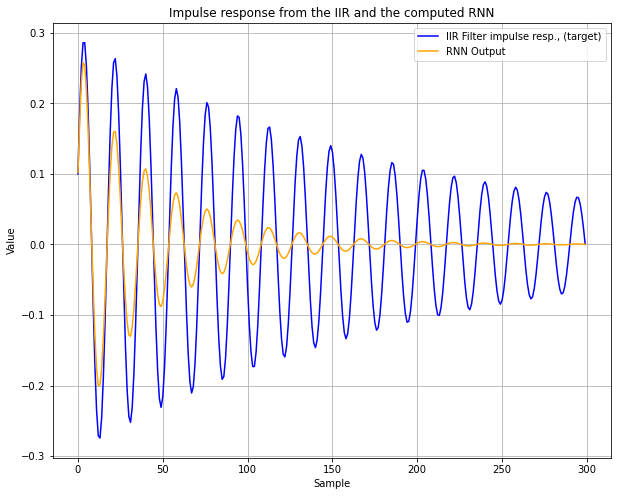

In [108]:
import matplotlib.pyplot as plt
plt.figure(figsize=(10,8))
plt.plot(filtered[:300], 'blue')
plt.plot(outsig[:300],'orange')
plt.legend(('IIR Filter impulse resp., (target)','RNN Output'))
plt.xlabel('Sample')
plt.ylabel('Value')
plt.title("Impulse response from the IIR and the computed RNN")
plt.grid()

Observe that we now have an even better fit than with our pre-computed weights. This is because the training was able to partly compensate the effects of the non-linear activation function (the tanh).

This approach can now be used to **generate sound**, and also to **detect sound**. For instance this RNN could be used to generate Xylophone or bell sounds.

Each impulse at its input is like an attack for a certain note of the Xylophone or bell. Different targets in the training result in different sounds.

Observe that this is now more generic than an IIR filter, and hence more sounds could be produced.

Matched filter theory states that a filter is maximizing the Signal to Noise Ratio for a signal which is the time-reversed of its impulse response (see our slide set on convolutional neural networks). Since RNNs have long impulse responses, they can hence **detect long signals or sequences.**